# Filter Size vs. Number of Filters

## GPU Check

In [1]:
import tensorflow as tf
from tensorflow.python.client import device_lib

numGPUs = len(tf.config.experimental.list_physical_devices('GPU'))

print('Num GPUs Available: ', numGPUs)

if numGPUs > 0:
    print(tf.test.gpu_device_name())
    print(device_lib.list_local_devices()[1].physical_device_desc)
    print(device_lib.list_local_devices()[2].physical_device_desc)

Num GPUs Available:  2
/device:GPU:0
device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:2d:00.0, compute capability: 8.6
device: 1, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:2e:00.0, compute capability: 8.6


## Import Libraries

In [2]:
import numpy as np
import pandas as pd
import tensorflow as tf

from scipy.special import entr
from sklearn.model_selection import train_test_split
from tensorflow.keras.datasets import mnist
from tensorflow.keras.utils import to_categorical

import matplotlib.pyplot as plt

## Preprocess Data

In [3]:
# load MNIST
((trainX, trainY), (testX, testY)) = mnist.load_data()

# edit shapes to make Keras happy
trainX = np.expand_dims(trainX, -1)
testX = np.expand_dims(testX, -1)

trainX, validationX, trainY, validationY = train_test_split(trainX, trainY, random_state = 0)

# save the integer labels
trainY_int = trainY
validationY_int = validationY
testY_int = testY

# turn labels into one-hot vectors
trainY = to_categorical(trainY, 10)
validationY = to_categorical(validationY, 10)
testY = to_categorical(testY, 10)

## Train and Tune a Basic CNN

In [5]:
import tensorflow as tf

from sklearn.metrics import classification_report
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import InputLayer
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import RandomRotation
from tensorflow.keras.layers import RandomTranslation
from tensorflow.keras.layers import RandomZoom
from tensorflow.keras.layers import Rescaling
from tensorflow.keras.models import load_model
from tensorflow.keras.models import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam

# create a sandwich CNN
class SandwichCNN:
    # create the architecture
    def build(height, width, depth, classes, num_filters, filter_size, activation, conv_blocks, dropout = None, augment = None):
        # create a feedforward neural net
        model = Sequential()
        
        model.add(InputLayer(input_shape = (height, width, depth,)))
        
        model.add(Rescaling(1./255.))
        
        if augment:
            #model.add(RandomRotation(0.1))
            model.add(RandomTranslation((-0.05, 0.05), (-0.05, 0.05)))
            #model.add(RandomZoom(0.1))
        
        for block in range(conv_blocks):
            # add a convolutional layer with 32 3x3 filters and a 2x2 max pooling layer
            model.add(Conv2D(num_filters, (filter_size, filter_size)))
            model.add(Activation(activation))
            model.add(MaxPooling2D(pool_size = (2, 2), strides = 2))
            
            if dropout:
                model.add(Dropout(dropout))
        
        # flatten the data
        model.add(Flatten())
        
        # add a softmax classifier
        model.add(Dense(classes))
        model.add(Activation('softmax'))
        
        # return the constructed model
        return model
    
def train_sandwich_CNN(trainX, trainY, validationX, validationY, num_filters, filter_size, activation, conv_blocks, epochs, opt, dropout = None, augment = None):
    
    # create an early stopping callback
    early_stopper = EarlyStopping(patience = 10, restore_best_weights = True)
    callbacks = [early_stopper]
    
    # dimensions of data
    height = trainX.shape[1]
    width = trainX.shape[2]
    depth = trainX.shape[3]
    classes = trainY.shape[1]
    
    # build the model
    model = SandwichCNN.build(height, width, depth, classes, num_filters, filter_size, activation, conv_blocks, dropout, augment)

    # compile the model by choosing how the optimizer works
    model.compile(loss = 'categorical_crossentropy', optimizer = opt, metrics = ['accuracy'])

    # fit the model
    H = model.fit(trainX, trainY, validation_data = (validationX, validationY), epochs = epochs, batch_size = 128, callbacks = callbacks, verbose = 0)
    
    # return history
    return H, model

## Gridsearch of Number of Filters vs. Filter Size

In [ ]:
epochs = 1000
conv_blocks = 1
activation = 'sigmoid'

# 4, 8, 16, 32, 64 filters
filters = [4, 8, 16, 32, 64]

# 1, 3, 5, 7, 9, 11 filter sizes
filter_sizes = [1, 3, 5, 7, 9, 11]

model_details = []

# loop through filters
for num_filters in filters:
        
    print('\n================================ 1-Layer CNN with', num_filters, 'Convolutional Filters ================================\n')

    # loop through numbers of filters
    for filter_size in filter_sizes:
            
        H, model = train_sandwich_CNN(trainX, trainY, validationX, validationY,
                                      num_filters, filter_size, activation, conv_blocks,
                                      epochs, Adam())
            
        validation_loss = H.history['val_loss'][-1]
        validation_accuracy = H.history['val_accuracy'][-1]
        stopping_epoch = H.epoch[-1] + 1

        # print model performance
        print('Filter Size:', filter_size,
              '\t Parameters:', model.count_params(),
              '\t Validation CE:', format(validation_loss, '.4f'),
              '\t Validation Acc:', format(validation_accuracy, '.4f'),
              '\t Stopping Epoch:', stopping_epoch)
        
        filename = 'CNN_MNIST_nf_' + str(num_filters) + '_fs_' + str(filter_size) + '.h5'
        
        model.save(filename)
        
        model_details.append([filename, num_filters, filter_size, model.count_params(), validation_loss, validation_accuracy,
                              stopping_epoch])


================================ 1-Layer CNN with 4 Convolutional Filters ================================

Filter Size: 1 	 Parameters: 7858 	 Validation CE: 0.2586 	 Validation Acc: 0.9251 	 Stopping Epoch: 70
Filter Size: 3 	 Parameters: 6810 	 Validation CE: 0.0976 	 Validation Acc: 0.9707 	 Stopping Epoch: 90
Filter Size: 5 	 Parameters: 5874 	 Validation CE: 0.0693 	 Validation Acc: 0.9790 	 Stopping Epoch: 75
Filter Size: 7 	 Parameters: 5050 	 Validation CE: 0.0605 	 Validation Acc: 0.9806 	 Stopping Epoch: 74
Filter Size: 9 	 Parameters: 4338 	 Validation CE: 0.0610 	 Validation Acc: 0.9807 	 Stopping Epoch: 85
Filter Size: 11 	 Parameters: 3738 	 Validation CE: 0.0671 	 Validation Acc: 0.9781 	 Stopping Epoch: 73

================================ 1-Layer CNN with 8 Convolutional Filters ================================

Filter Size: 1 	 Parameters: 15706 	 Validation CE: 0.2527 	 Validation Acc: 0.9279 	 Stopping Epoch: 45
Filter Size: 3 	 Parameters: 13610 	 Validation CE: 

In [ ]:
model_df = pd.DataFrame(model_details, columns = ['Filename', 'Number of Filters', 'Filter Size', 'Parameters',
                                                  'Val Loss', 'Val Acc', 'Stopping Epoch'])

model_df

,Filename,Number of Filters,Filter Size,Parameters,Val Loss,Val Acc,Stopping Epoch
0,CNN_MNIST_nf_4_fs_1.h5,4,1,7858,0.258617,0.925133,70
1,CNN_MNIST_nf_4_fs_3.h5,4,3,6810,0.097555,0.970667,90
2,CNN_MNIST_nf_4_fs_5.h5,4,5,5874,0.069292,0.979000,75
3,CNN_MNIST_nf_4_fs_7.h5,4,7,5050,0.060527,0.980600,74
4,CNN_MNIST_nf_4_fs_9.h5,4,9,4338,0.060997,0.980667,85
5,CNN_MNIST_nf_4_fs_11.h5,4,11,3738,0.067145,0.978067,73
6,CNN_MNIST_nf_8_fs_1.h5,8,1,15706,0.252654,0.927933,45
7,CNN_MNIST_nf_8_fs_3.h5,8,3,13610,0.072108,0.978067,92
8,CNN_MNIST_nf_8_fs_5.h5,8,5,11738,0.055093,0.983200,81
9,CNN_MNIST_nf_8_fs_7.h5,8,7,10090,0.057393,0.982733,54


## Function to Extract Internal Representations

In [4]:
def extract_layers(model, data, layer):

    # Extracts the outputs of all layers
    layer_outputs = model.layers[layer].output

    # Creates a model that will return these outputs, given the model input
    activation_model = Model(inputs = model.input, outputs = layer_outputs)

    # returns a list of numpy arrays: one array per layer activation
    activations = activation_model.predict(data, verbose = 0)
    
    return activations

## Entropy-based Pruning

### Extracting Feature Map Entropies

In [ ]:
# layer 1 = CNN pre-activation
# layer 2 = CNN activation
# layer 5 = Scores
# layer 6 = Probabilities

entropy_lists = []

for filename, num_filters, filter_size in zip(model_df['Filename'], model_df['Number of Filters'], model_df['Filter Size']):
    
    model = load_model(filename)
    print('Computing filter-level entropies for model with', num_filters, 'filters of size', filter_size, 'x', filter_size)
    #print('Extracting feature maps from model', filename)
    
    feature_maps = extract_layers(model, testX, 2)
    
    entropy_list = []
    
    #print('Computing entropy for each pruned filter...')
    
    for j in range(num_filters):
                
        # extract activations for the jth filter
        filter_activation = np.array(feature_maps[:, :, :, j])

        # find the entropy of the activations of the filter
        filter_entropy = entr(filter_activation).sum(axis = 0).mean()

        # add [filter number, entropy] to the list
        entropy_list.append(filter_entropy)
        
    entropy_lists.append(entropy_list)
    
model_df['Filter Entropies'] = entropy_lists

Computing filter-level entropies for model with 4 filters of size 1 x 1
Computing filter-level entropies for model with 4 filters of size 3 x 3
Computing filter-level entropies for model with 4 filters of size 5 x 5
Computing filter-level entropies for model with 4 filters of size 7 x 7
Computing filter-level entropies for model with 4 filters of size 9 x 9
Computing filter-level entropies for model with 4 filters of size 11 x 11
Computing filter-level entropies for model with 8 filters of size 1 x 1
Computing filter-level entropies for model with 8 filters of size 3 x 3
Computing filter-level entropies for model with 8 filters of size 5 x 5
Computing filter-level entropies for model with 8 filters of size 7 x 7
Computing filter-level entropies for model with 8 filters of size 9 x 9
Computing filter-level entropies for model with 8 filters of size 11 x 11
Computing filter-level entropies for model with 16 filters of size 1 x 1
Computing filter-level entropies for model with 16 filters 

### Entropy-based Pruning (ascending)

In [ ]:
 # details we will add to the df for each model
model_details = []
    
for filename, num_filters, filter_size, filter_entropies in zip(model_df['Filename'],
                                                                model_df['Number of Filters'],
                                                                model_df['Filter Size'],
                                                                model_df['Filter Entropies']):
        
    print('Pruning filters by ascending entropies for a model with', num_filters, 'filters of size', filter_size, 'x', filter_size)
    
    # load the model
    model = load_model(filename)
            
    # sort filter indices in ascending order of filter entropy
    filter_entropy_ascending_args = np.hstack([None, np.argsort(np.array(filter_entropies))])

    test_losses = []
    test_accuracies = []
    scoreses = []
    probabilitieses = []
    predictedYs = []
    
    for pruned_filter_index in filter_entropy_ascending_args:
        
        if pruned_filter_index:
            # get the weights
            weights = model.get_weights()

            # set the removed filter and current filter weights and biases to 0
            weights[0][:, :, 0, pruned_filter_index] *= 0
            weights[1][pruned_filter_index] *= 0
            model.set_weights(weights)

        # compute validation accuracy after removing the current filter
        test_loss, test_accuracy = model.evaluate(testX, testY, verbose = 0)
        
        test_losses.append(test_loss)
        test_accuracies.append(test_accuracy)
                
        # scores
        scores = extract_layers(model, testX, 5)
        scoreses.append(scores)

        # probabilities
        probabilities = extract_layers(model, testX, 6)
        probabilitieses.append(probabilities)
        
    model_details.append([test_losses, test_accuracies, scoreses, probabilitieses])
    
new_columns = ['Test CE (asc)', 'Test Acc (asc)', 'Scores (asc)', 'Probabilities (asc)']
model_df[new_columns] = pd.DataFrame(model_details)

Pruning filters by ascending entropies for a model with 4 filters of size 1 x 1
Pruning filters by ascending entropies for a model with 4 filters of size 3 x 3
Pruning filters by ascending entropies for a model with 4 filters of size 5 x 5
Pruning filters by ascending entropies for a model with 4 filters of size 7 x 7
Pruning filters by ascending entropies for a model with 4 filters of size 9 x 9
Pruning filters by ascending entropies for a model with 4 filters of size 11 x 11
Pruning filters by ascending entropies for a model with 8 filters of size 1 x 1
Pruning filters by ascending entropies for a model with 8 filters of size 3 x 3
Pruning filters by ascending entropies for a model with 8 filters of size 5 x 5
Pruning filters by ascending entropies for a model with 8 filters of size 7 x 7
Pruning filters by ascending entropies for a model with 8 filters of size 9 x 9
Pruning filters by ascending entropies for a model with 8 filters of size 11 x 11
Pruning filters by ascending entropi

### Entropy-based Pruning (descending)

In [ ]:
 # details we will add to the df for each model
model_details = []
    
for filename, num_filters, filter_size, filter_entropies in zip(model_df['Filename'],
                                                                model_df['Number of Filters'],
                                                                model_df['Filter Size'],
                                                                model_df['Filter Entropies']):
        
    print('Pruning filters by descending entropies for a model with', num_filters,
          'filters of size', filter_size, 'x', filter_size)
    
    # load the model
    model = load_model(filename)
            
    # sort filter indices in ascending order of filter entropy
    filter_entropy_descending_args = np.hstack([None, np.argsort(np.array(filter_entropies))[::-1]])

    test_losses = []
    test_accuracies = []
    scoreses = []
    probabilitieses = []
    
    for pruned_filter_index in filter_entropy_descending_args:
        
        if pruned_filter_index:
            # get the weights
            weights = model.get_weights()

            # set the removed filter and current filter weights and biases to 0
            weights[0][:, :, 0, pruned_filter_index] *= 0
            weights[1][pruned_filter_index] *= 0
            model.set_weights(weights)

        # compute validation accuracy after removing the current filter
        test_loss, test_accuracy = model.evaluate(testX, testY, verbose = 0)
        
        test_losses.append(test_loss)
        test_accuracies.append(test_accuracy)
                
        # scores
        scores = extract_layers(model, testX, 5)
        scoreses.append(scores)

        # probabilities
        probabilities = extract_layers(model, testX, 6)
        probabilitieses.append(probabilities)
        
        # COMPUTE MSE, KL DIV, AND MI BETWEEN PROBABILITIES AND ONE-HOT LABELS
        
        # COMPUTE MEAN SCORE/PROBABILITY FOR CORRECT CLASS IN ALL TEST POINTS
        
        # COMPUTE MEAN SCORE/PROBABILITY (DISTRIBUTIONS) FOR ALL CLASSES IN TEST POINTS FROM EACH CLASS
        
    model_details.append([test_losses, test_accuracies, scoreses, probabilitieses])
    
new_columns = ['Test CE (desc)', 'Test Acc (desc)', 'Scores (desc)', 'Probabilities (desc)']
model_df[new_columns] = pd.DataFrame(model_details)

Pruning filters by descending entropies for a model with 4 filters of size 1 x 1
Pruning filters by descending entropies for a model with 4 filters of size 3 x 3
Pruning filters by descending entropies for a model with 4 filters of size 5 x 5
Pruning filters by descending entropies for a model with 4 filters of size 7 x 7
Pruning filters by descending entropies for a model with 4 filters of size 9 x 9
Pruning filters by descending entropies for a model with 4 filters of size 11 x 11
Pruning filters by descending entropies for a model with 8 filters of size 1 x 1
Pruning filters by descending entropies for a model with 8 filters of size 3 x 3
Pruning filters by descending entropies for a model with 8 filters of size 5 x 5
Pruning filters by descending entropies for a model with 8 filters of size 7 x 7
Pruning filters by descending entropies for a model with 8 filters of size 9 x 9
Pruning filters by descending entropies for a model with 8 filters of size 11 x 11
Pruning filters by desce

In [ ]:
model_df.to_pickle('Filter_Number_vs_Size_Prune_Data.pkl')

### Entropy-based Pruning Plots

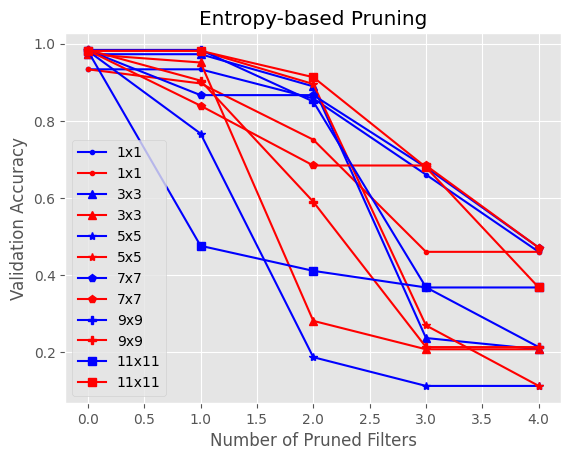

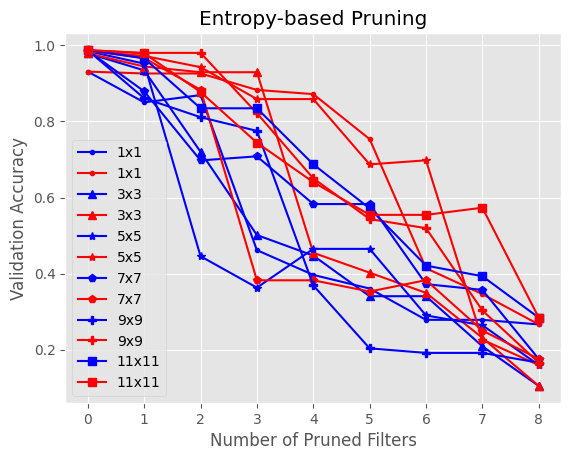

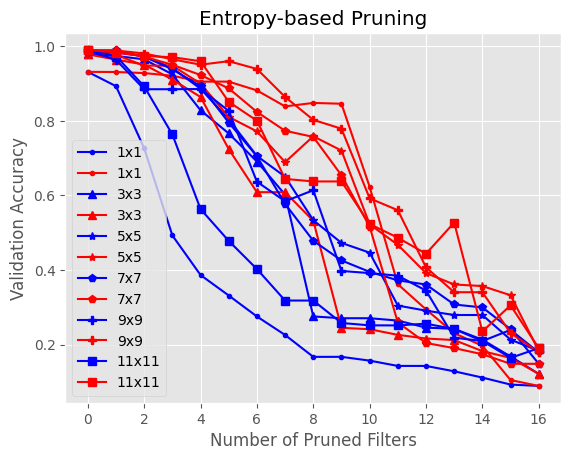

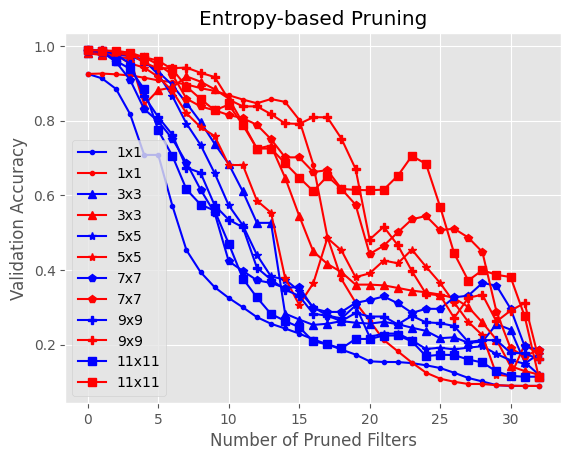

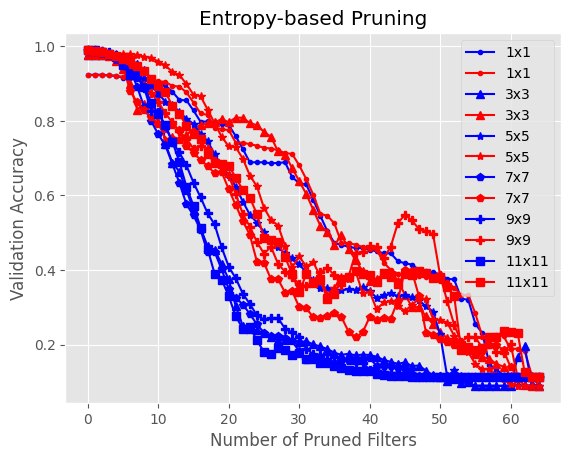

In [ ]:
for num_filters in filters:
    ascending_pruned = model_df[model_df['Number of Filters'] == num_filters][['Filter Size', 'Test Acc (asc)']]
    descending_pruned = model_df[model_df['Number of Filters'] == num_filters][['Filter Size', 'Test Acc (desc)']]

    asc = ascending_pruned.values.tolist()
    desc = descending_pruned.values.tolist()

    plt.style.use('ggplot')
    plt.figure()

    markers = ['.', '^', '*', 'p', 'P', 's']

    for i, (x, y) in enumerate(zip(asc, desc)):
        plt.plot(x[1], color = 'blue', marker = markers[i], label = str(x[0]) + 'x' + str(x[0]))
        plt.plot(y[1], color = 'red', marker = markers[i], label = str(y[0]) + 'x' + str(y[0]))

    plt.ylabel('Validation Accuracy')
    plt.xlabel('Number of Pruned Filters')
    plt.title('Entropy-based Pruning')

    plt.legend()

## Distribution Analysis

In [7]:
model_df = pd.read_pickle('../Filter_Number_vs_Size_Prune_Data.pkl')
model_df

,Filename,Number of Filters,Filter Size,Parameters,Val Loss,Val Acc,Stopping Epoch,Filter Entropies,Test CE (asc),Test Acc (asc),Scores (asc),Probabilities (asc),Test CE (desc),Test Acc (desc),Scores (desc),Probabilities (desc)
0,CNN_MNIST_nf_4_fs_1.h5,4,1,7858,0.258617,0.925133,70,"[2366.1152, 2881.8699, 2636.2053, 2802.155]","[0.23633383214473724, 0.23633383214473724, 0.4...","[0.9337000250816345, 0.9337000250816345, 0.858...","[[[-2.8872085, -8.445196, -0.6331814, 3.647106...","[[[6.4419174e-07, 2.4843454e-09, 6.1365795e-06...","[0.23633383214473724, 0.3445681631565094, 0.81...","[0.9337000250816345, 0.8970999717712402, 0.751...","[[[-2.8872085, -8.445196, -0.6331814, 3.647106...","[[[6.4419174e-07, 2.4843454e-09, 6.1365795e-06..."
1,CNN_MNIST_nf_4_fs_3.h5,4,3,6810,0.097555,0.970667,90,"[1450.2373, 1889.8513, 2494.399, 2870.5117]","[0.08488759398460388, 0.08488759398460388, 0.3...","[0.9728999733924866, 0.9728999733924866, 0.889...","[[[-0.703073, -3.9267519, 0.758875, 0.78004235...","[[[1.7896625e-06, 7.1243505e-08, 7.721235e-06,...","[0.08488759398460388, 0.16300536692142487, 5.9...","[0.9728999733924866, 0.9513999819755554, 0.281...","[[[-0.703073, -3.9267519, 0.758875, 0.78004235...","[[[1.7896625e-06, 7.1243505e-08, 7.721235e-06,..."
2,CNN_MNIST_nf_4_fs_5.h5,4,5,5874,0.069292,0.979000,75,"[2317.7693, 2184.9363, 1923.4052, 1764.4299]","[0.05770454183220863, 0.7826946973800659, 9.83...","[0.9818999767303467, 0.7670999765396118, 0.187...","[[[-4.8456774, -5.1222696, -1.14375, 0.4546483...","[[[1.0058188e-08, 7.627763e-09, 4.0761174e-07,...","[0.05770454183220863, 0.05770454183220863, 0.3...","[0.9818999767303467, 0.9818999767303467, 0.895...","[[[-4.8456774, -5.1222696, -1.14375, 0.4546483...","[[[1.0058188e-08, 7.627763e-09, 4.0761174e-07,..."
3,CNN_MNIST_nf_4_fs_7.h5,4,7,5050,0.060527,0.980600,74,"[1685.9886, 1585.5051, 1859.4076, 1803.5609]","[0.05369509756565094, 0.41513633728027344, 0.4...","[0.9829999804496765, 0.8668000102043152, 0.866...","[[[-4.084132, -12.053371, 4.381237, 2.3178847,...","[[[1.1380918e-07, 3.9371385e-11, 0.0005403068,...","[0.05369509756565094, 0.5950075387954712, 1.14...","[0.9829999804496765, 0.8393999934196472, 0.684...","[[[-4.084132, -12.053371, 4.381237, 2.3178847,...","[[[1.1380918e-07, 3.9371385e-11, 0.0005403068,..."
4,CNN_MNIST_nf_4_fs_9.h5,4,9,4338,0.060997,0.980667,85,"[1128.3992, 1446.1262, 1301.7311, 1896.4194]","[0.05162152647972107, 0.05162152647972107, 0.5...","[0.984000027179718, 0.984000027179718, 0.85009...","[[[-4.917421, -3.248858, 1.0285349, 0.7438547,...","[[[1.2929813e-08, 6.8586765e-08, 4.941835e-06,...","[0.05162152647972107, 0.25793197751045227, 2.3...","[0.984000027179718, 0.9045000076293945, 0.5903...","[[[-4.917421, -3.248858, 1.0285349, 0.7438547,...","[[[1.2929813e-08, 6.8586765e-08, 4.941835e-06,..."
5,CNN_MNIST_nf_4_fs_11.h5,4,11,3738,0.067145,0.978067,73,"[1431.598, 1373.4409, 876.6305, 1155.6974]","[0.05938563123345375, 2.6950106620788574, 5.42...","[0.9817000031471252, 0.47609999775886536, 0.41...","[[[-4.989677, -4.7392797, 0.7110478, -0.577029...","[[[1.7776818e-08, 2.2834943e-08, 5.3167623e-06...","[0.05938563123345375, 0.05938563123345375, 0.2...","[0.9817000031471252, 0.9817000031471252, 0.913...","[[[-4.989677, -4.7392797, 0.7110478, -0.577029...","[[[1.7776818e-08, 2.2834943e-08, 5.3167623e-06..."
6,CNN_MNIST_nf_8_fs_1.h5,8,1,15706,0.252654,0.927933,45,"[3110.806, 2911.9165, 3027.2659, 3081.6035, 28...","[0.24293376505374908, 0.4593557119369507, 0.43...","[0.9311000108718872, 0.8501999974250793, 0.869...","[[[-1.0393652, -7.43613, 1.1309444, 4.1636114,...","[[[1.4259946e-06, 2.3770494e-09, 1.2493125e-05...","[0.24293376505374908, 0.2611188590526581, 0.26...","[0.9311000108718872, 0.9261999726295471, 0.926...","[[[-1.0393652, -7.43613, 1.1309444, 4.1636114,...","[[[1.4259946e-06, 2.3770494e-09, 1.2493125e-05..."
7,CNN_MNIST_nf_8_fs_3.h5,8,3,13610,0.072108,0.978067,92,"[2689.9006, 2991.408, 1861.1396, 1872.4945, 20...","[0.0675746276974678, 0.2038022279

In [8]:
model_df.columns

Index(['Filename', 'Number of Filters', 'Filter Size', 'Parameters',
       'Val Loss', 'Val Acc', 'Stopping Epoch', 'Filter Entropies',
       'Test CE (asc)', 'Test Acc (asc)', 'Scores (asc)',
       'Probabilities (asc)', 'Test CE (desc)', 'Test Acc (desc)',
       'Scores (desc)', 'Probabilities (desc)'],
      dtype='object')

/tmp/ipykernel_1796915/1873775807.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


<Figure size 640x480 with 0 Axes>

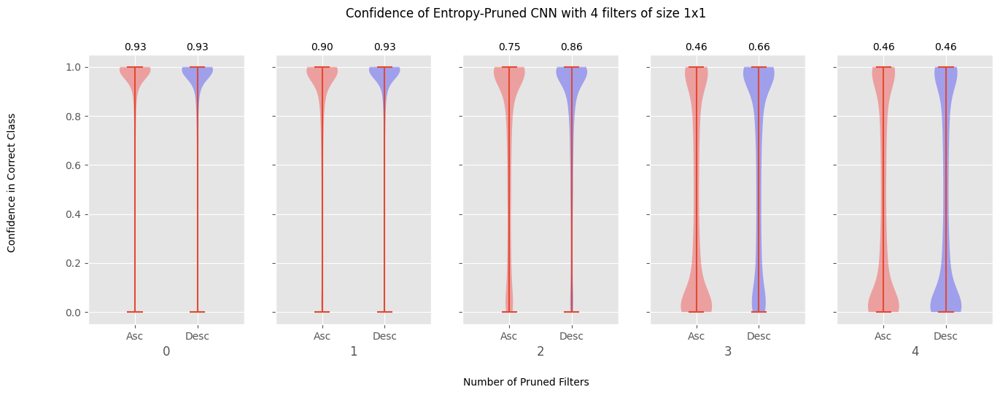

<Figure size 640x480 with 0 Axes>

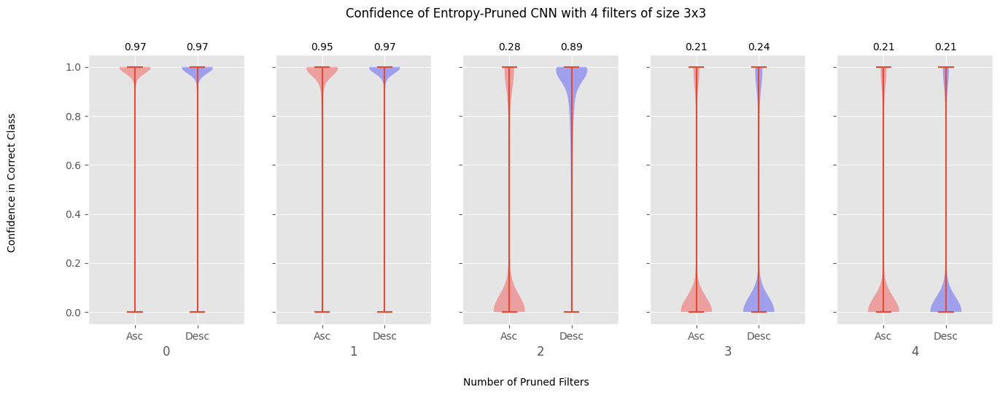

<Figure size 640x480 with 0 Axes>

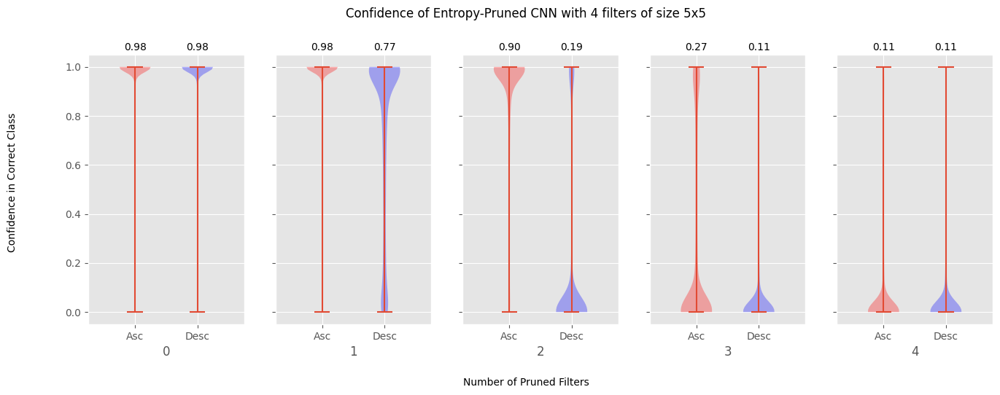

<Figure size 640x480 with 0 Axes>

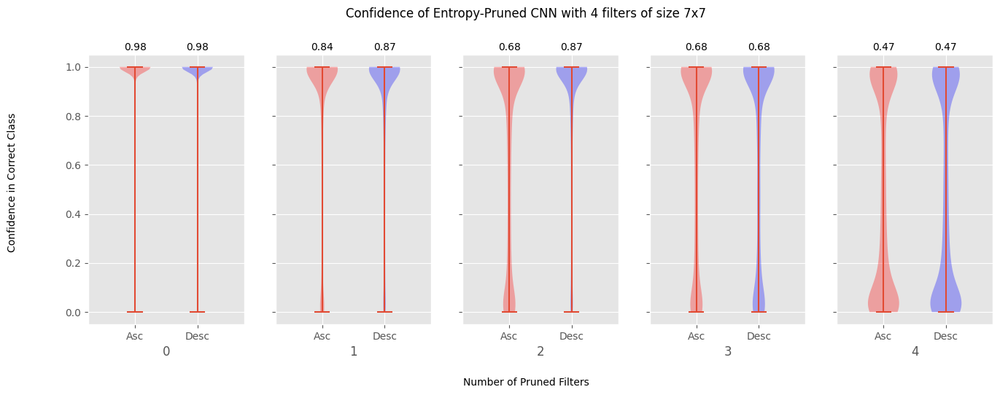

<Figure size 640x480 with 0 Axes>

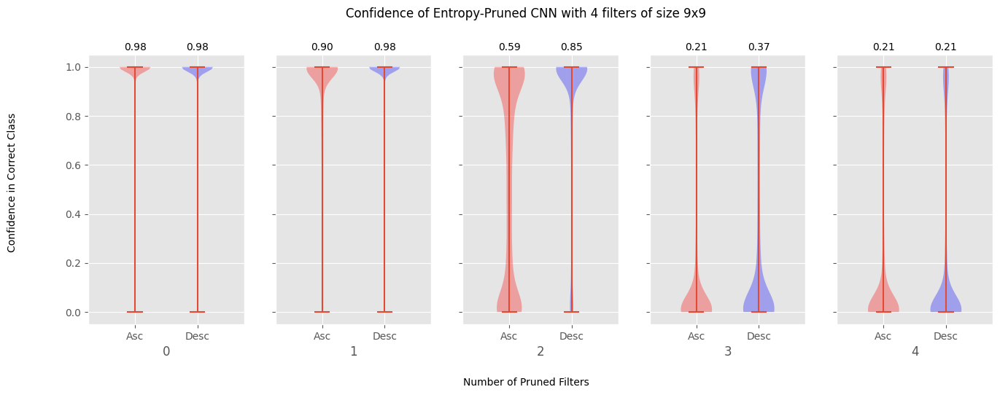

<Figure size 640x480 with 0 Axes>

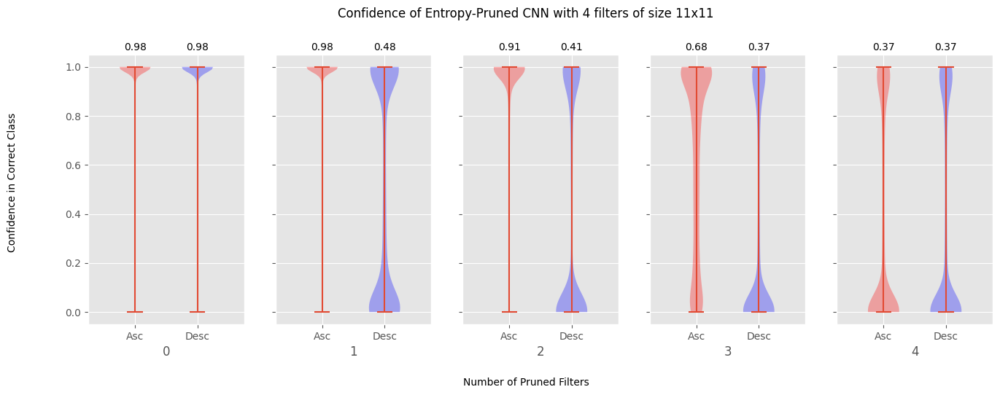

<Figure size 640x480 with 0 Axes>

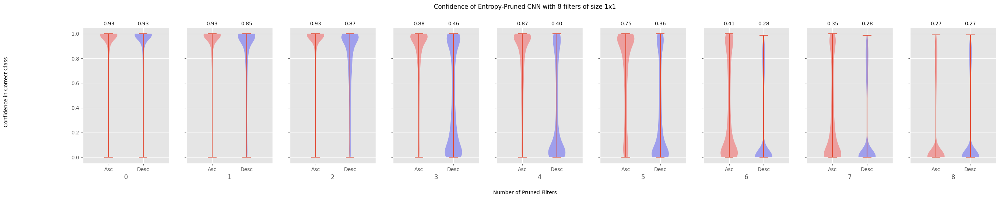

<Figure size 640x480 with 0 Axes>

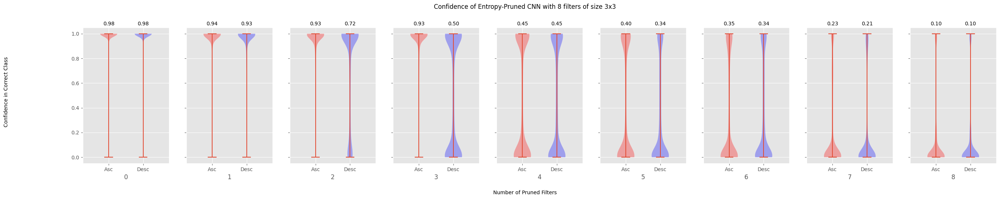

<Figure size 640x480 with 0 Axes>

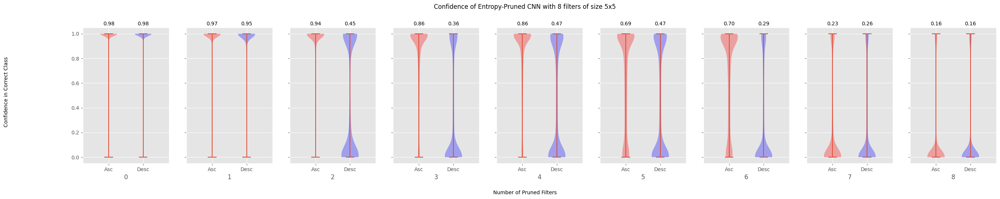

<Figure size 640x480 with 0 Axes>

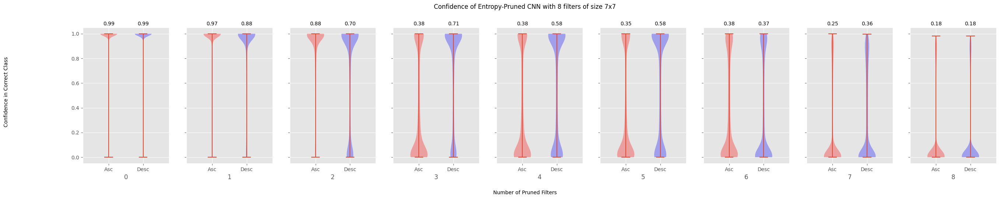

<Figure size 640x480 with 0 Axes>

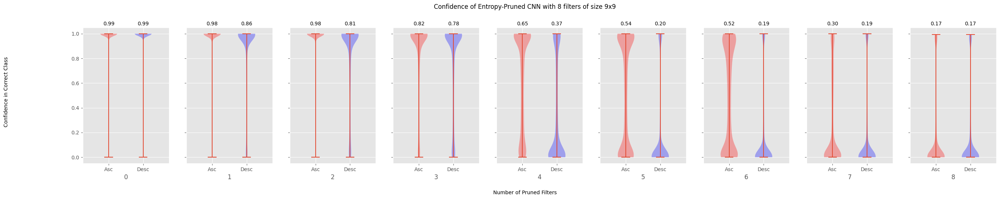

<Figure size 640x480 with 0 Axes>

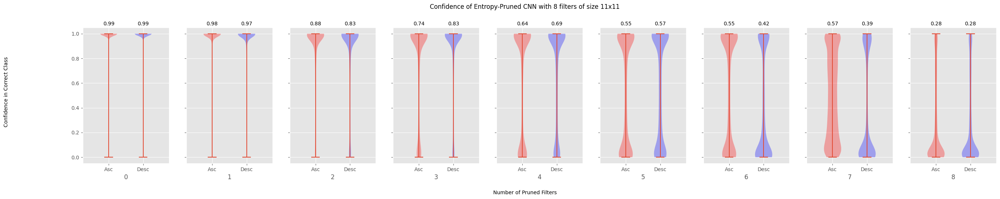

<Figure size 640x480 with 0 Axes>

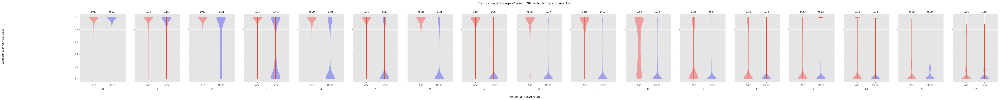

<Figure size 640x480 with 0 Axes>

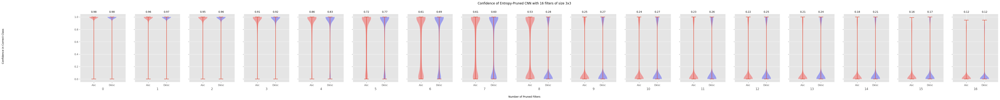

<Figure size 640x480 with 0 Axes>

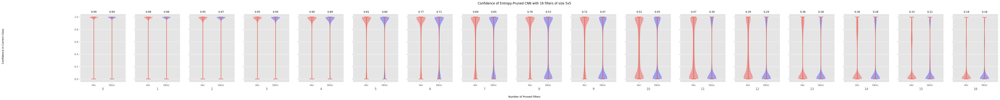

<Figure size 640x480 with 0 Axes>

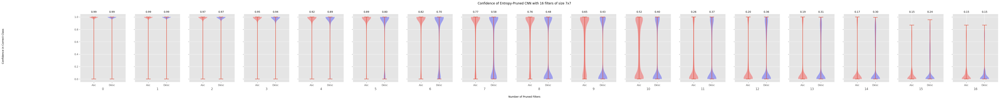

<Figure size 640x480 with 0 Axes>

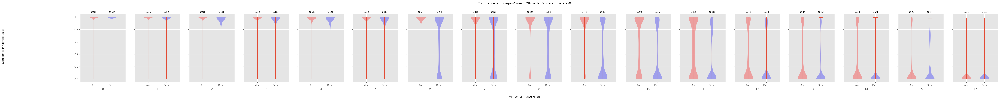

<Figure size 640x480 with 0 Axes>

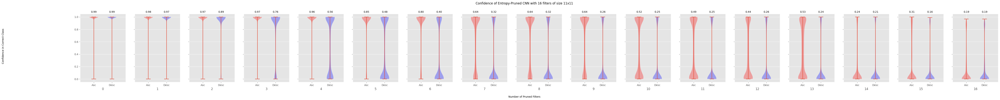

<Figure size 640x480 with 0 Axes>

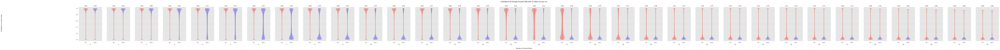

<Figure size 640x480 with 0 Axes>

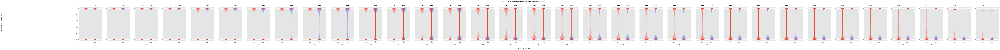

<Figure size 640x480 with 0 Axes>

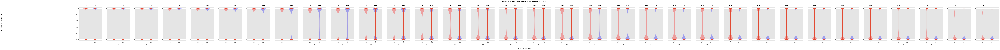

<Figure size 640x480 with 0 Axes>

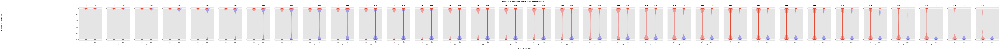

<Figure size 640x480 with 0 Axes>

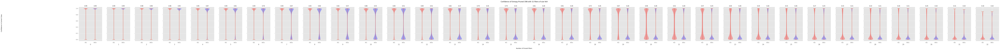

<Figure size 640x480 with 0 Axes>

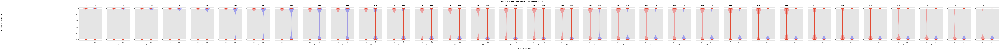

<Figure size 640x480 with 0 Axes>

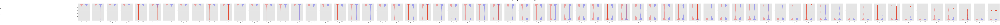

<Figure size 640x480 with 0 Axes>

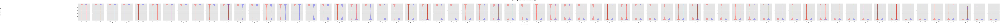

<Figure size 640x480 with 0 Axes>

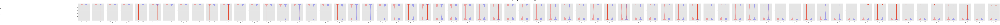

<Figure size 640x480 with 0 Axes>

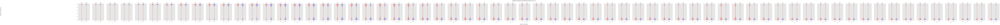

<Figure size 640x480 with 0 Axes>

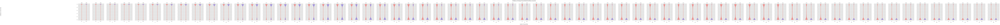

<Figure size 640x480 with 0 Axes>

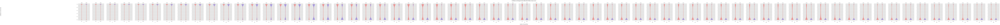

In [ ]:
i = 0

import matplotlib.patches as mpatches

from numpy.linalg import norm

def add_label(violin, label):
    color = violin["bodies"][0].get_facecolor().flatten()
    labels.append((mpatches.Patch(color=color), label))

for num_filters, filter_size, probabilities_desc, test_accs_desc, test_scores_desc, probabilities_asc, test_accs_asc, test_scores_asc in zip(model_df['Number of Filters'],
                                                                                                                                              model_df['Filter Size'],
                                                                                                                                              model_df['Probabilities (desc)'],
                                                                                                                                              model_df['Test Acc (desc)'],
                                                                                                                                              model_df['Scores (desc)'],
                                                                                                                                              model_df['Probabilities (asc)'],
                                                                                                                                              model_df['Test Acc (asc)'],
                                                                                                                                              model_df['Scores (asc)']):

    #if i == 6: continue
    i += 1

    #print('\nTest Accuracy -- Mean Score -- Mean Correct Prob -- Test MAE -- Mean Cosine Similarity\n')

    # COMPUTE MAE, KL DIV (not defined since 0's), AND MI (not needed...) BETWEEN PROBABILITIES AND ONE-HOT LABELS
    # COMPUTE MEAN SCORE/PROBABILITY (done) FOR CORRECT CLASS IN ALL TEST POINTS
    
    plt.style.use('ggplot')
    plt.figure()
        
    labels = []
    
    fig, axs = plt.subplots(nrows = 1, ncols = num_filters + 1, sharey='row', figsize=(num_filters * 4, 5))
    fig.text(0.06, 0.5, 'Confidence in Correct Class', ha='center', va='center', rotation='vertical')
    fig.text(0.5, -0.05, 'Number of Pruned Filters', ha='center', va='center')
    fig.subplots_adjust(top = 0.85)

    title = 'Confidence of Entropy-Pruned CNN with ' + str(num_filters) + ' filters of size ' + str(filter_size) + 'x' + str(filter_size)
    plt.suptitle(title)
        
    for j, (probs_desc, acc_desc, scores_desc, probs_asc, acc_asc, scores_asc) in enumerate(zip(probabilities_desc, test_accs_desc, test_scores_desc, probabilities_asc, test_accs_asc, test_scores_asc)):
        mean_correct_prob_desc = probs_desc[range(probs_desc.shape[0]), testY_int].mean()
        mean_correct_score_desc = scores_desc[range(probs_desc.shape[0]), testY_int].mean()
        mean_absolute_error_desc = np.abs(probs_desc - testY).sum(axis = 1).mean()
        mean_squared_error_desc = ((probs_desc - testY) ** 2).sum(axis = 1).mean()
        mean_cosine_similarity_asc = ((probs_desc * testY).sum(axis = 1)/norm(probs_desc, axis = 1)).mean()
        
        mean_correct_prob_asc = probs_desc[range(probs_desc.shape[0]), testY_int].mean()
        mean_correct_score_asc = scores_desc[range(probs_desc.shape[0]), testY_int].mean()
        mean_absolute_error_asc = np.abs(probs_desc - testY).sum(axis = 1).mean()
        mean_squared_error_asc = ((probs_desc - testY) ** 2).sum(axis = 1).mean()
        mean_cosine_similarity_asc = ((probs_desc * testY).sum(axis = 1)/norm(probs_desc, axis = 1)).mean()
        

        #print(mean_correct_prob, '\t\t', mean_correct_score, '\t', acc, '\t', mean_squared_error)
        #print('{:.4f} -- {:.4f} -- {:.4f} -- {:.4f} -- {:.4f}'.format(acc, mean_correct_score, mean_correct_prob,
        #                                                              mean_absolute_error, mean_cosine_similarity))
        # violin plots
        
        vp = axs[j].violinplot([probs_desc[range(probs_desc.shape[0]), testY_int], probs_asc[range(probs_asc.shape[0]), testY_int]])
        
        vp['bodies'][0].set_facecolor('red')
        vp['bodies'][1].set_facecolor('blue')
        
        axs[j].set_xlabel(str(j))

        accuracy_desc = '{:.2f}'.format(acc_asc)
        accuracy_asc = '{:.2f}'.format(acc_desc)
        axs[j].text(1, 1.1, accuracy_asc, ha='center', va='top')
        axs[j].text(2, 1.1, accuracy_desc, ha='center', va='top')
        
        axs[j].set_xticks(np.arange(1, 3), labels = ['Asc', 'Desc'])
        axs[j].set_xlim(0.25, 2 + 0.75)
        
    # COMPUTE MEAN SCORE/PROBABILITY (DISTRIBUTIONS) FOR ALL CLASSES IN TEST POINTS FROM EACH CLASS

In [ ]:
import imageio
from pathlib import Path

def plot_frame(frame, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc):
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111)

    probs_desc = probabilities_desc[frame]
    probs_asc = probabilities_asc[frame]

    acc_asc = test_accs_asc[frame]
    acc_desc = test_accs_desc[frame]

    vp = plt.violinplot([probs_desc[range(probs_desc.shape[0]), testY_int], probs_asc[range(probs_asc.shape[0]), testY_int]])

    vp['bodies'][0].set_facecolor('red')
    vp['bodies'][1].set_facecolor('blue')

    accuracy_desc = 'Acc: {:.2f}'.format(acc_asc)
    accuracy_asc = 'Acc: {:.2f}'.format(acc_desc)
    plt.text(1, 1.1, accuracy_asc, ha='center', va='top')
    plt.text(2, 1.1, accuracy_desc, ha='center', va='top')
        
    title = 'Confidence of Entropy-Pruned CNN with ' + str(num_filters) + ' filters of size ' + str(filter_size) + 'x' + str(filter_size)
    plt.title(title, y = 1.05)
    plt.ylabel('Confidence in Correct Class')
    
    xlabel = 'Pruned filters: ' + str(frame)
    plt.xlabel(xlabel)
    
    ax.set_xticks(np.arange(1, 3), labels = ['Asc', 'Desc'])
        
    Path(f'images/{num_filters}_filters/filter_size_{filter_size}/').mkdir(parents=True, exist_ok=True)
    plt.savefig(f'images/{num_filters}_filters/filter_size_{filter_size}/pruned_{frame:02d}.png', transparent = False, facecolor = 'white')
        
    plt.close()
    
i = 0
for num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc in zip(model_df['Number of Filters'],
                                                                                                          model_df['Filter Size'],
                                                                                                          model_df['Probabilities (desc)'],
                                                                                                          model_df['Test Acc (desc)'],
                                                                                                          model_df['Probabilities (asc)'],
                                                                                                          model_df['Test Acc (asc)']):

    #i += 1
    #if i == 1: continue
    #plot_frame(0, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc)
    
    for j in range(num_filters + 1):
        plot_frame(j, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc)
        
    frames = []
    for j in range(num_filters + 1):
        image = imageio.v2.imread(f'images/{num_filters}_filters/filter_size_{filter_size}/pruned_{j:02d}.png')
        frames.append(image)
        
    Path(f'gifs/').mkdir(parents=True, exist_ok=True)

    imageio.v2.mimsave(f'gifs/{num_filters}_filters_filter_size_{filter_size}.gif', frames, duration = 400)

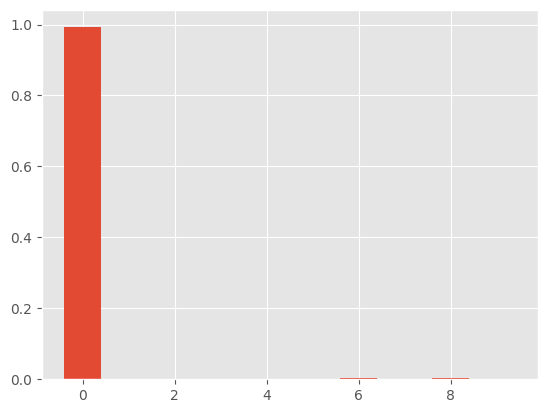

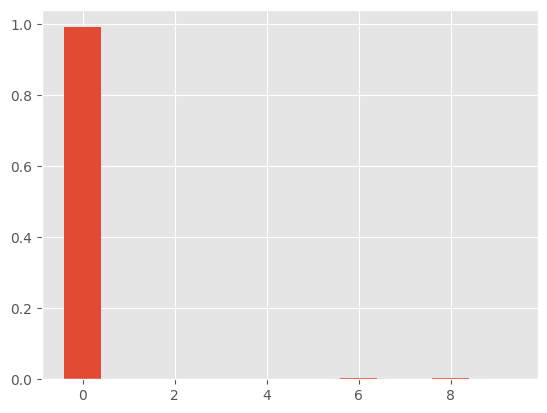

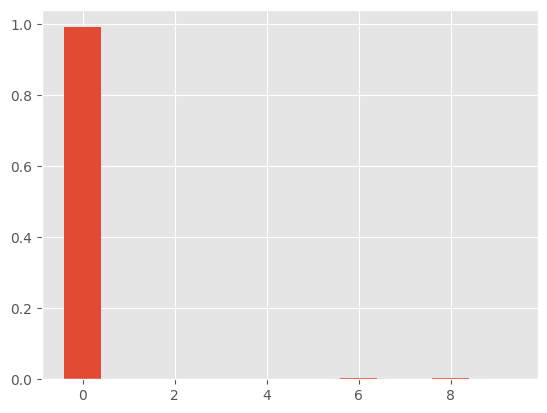

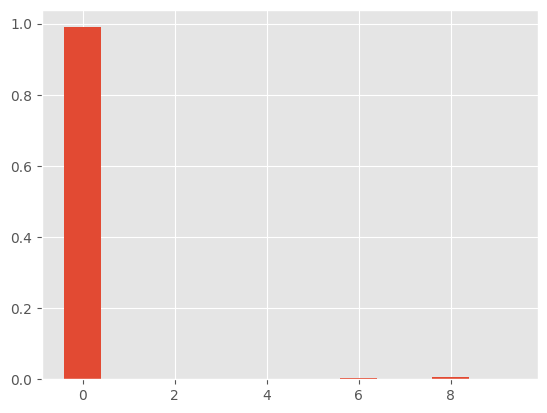

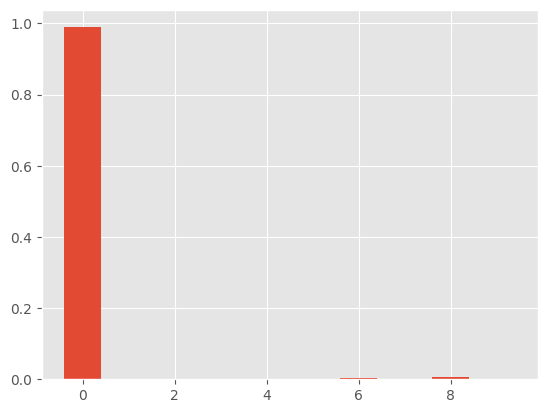

...

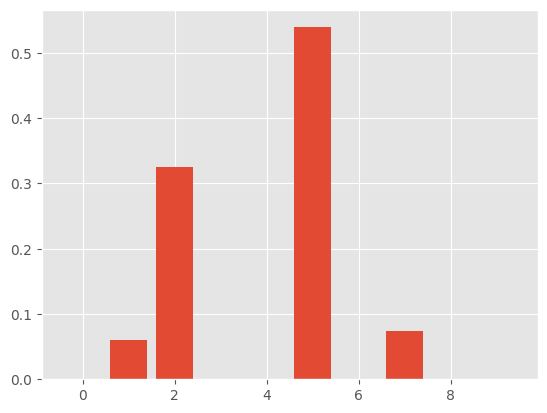

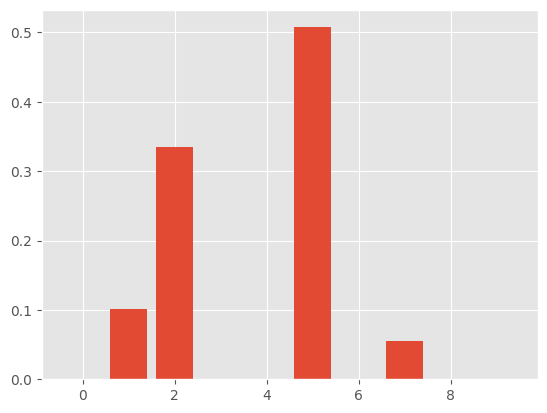

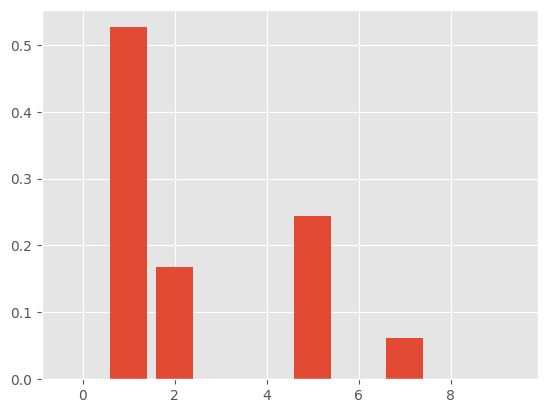

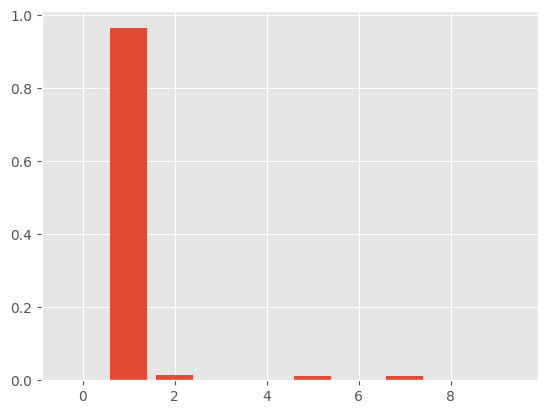

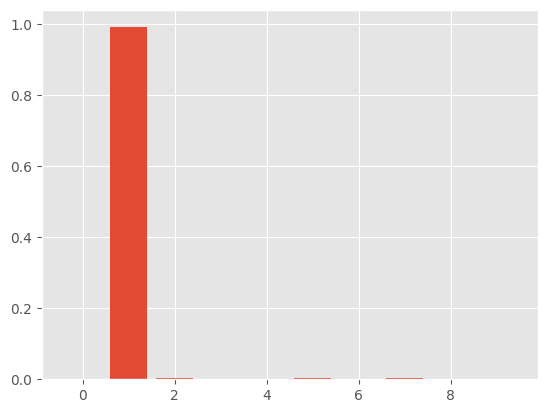

In [ ]:
plt.figure()
for frame in range(65):
    probs_desc = probabilities_desc[frame]
    probs_asc = probabilities_asc[frame]

    probs_desc_class = probs_desc[testY_int == 0,:].mean(axis = 0)
    probs_asc_class = probs_asc[testY_int == 0,:].mean(axis = 0)
    
    plt.bar(range(10), probs_desc_class)
    
    plt.show()

In [ ]:
def plot_frame(frame, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc, digit):
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111)

    probs_desc = probabilities_desc[frame]
    probs_asc = probabilities_asc[frame]

    acc_asc = test_accs_asc[frame]
    acc_desc = test_accs_desc[frame]

    probs_desc_class = probs_desc[testY_int == digit,:].mean(axis = 0)
    probs_asc_class = probs_asc[testY_int == digit,:].mean(axis = 0)

    plt.bar([x - 0.25 for x in range(10)], probs_desc_class, width = 0.5)
    plt.bar([x + 0.25 for x in range(10)], probs_asc_class, width = 0.5)
    
    accuracy_desc = 'Descending Model Acc: {:.2f}'.format(acc_desc)
    accuracy_asc = 'Accending Model Acc: {:.2f}'.format(acc_asc)
    plt.text(5, 0.9, accuracy_desc, ha='center', va='top')
    plt.text(5, 0.8, accuracy_asc, ha='center', va='top')

    title = f'Prediction Distribution for {k}s in Entropy-Pruned CNN with {num_filters} filters of size {filter_size} x {filter_size}'
    plt.title(title)
    plt.ylabel('Estimated Probability')
    plt.ylim(0, 1)
    
    xlabel = 'Pruned filters: ' + str(frame)
    plt.xlabel(xlabel)
    plt.xticks(range(10))

    Path(f'dist_images/{num_filters}_filters/filter_size_{filter_size}/').mkdir(parents=True, exist_ok=True)
    plt.savefig(f'dist_images/{num_filters}_filters/filter_size_{filter_size}/pruned_{frame:02d}_digit_{digit}.png', transparent = False, facecolor = 'white')

    plt.close()
    
#i = 0
#for num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc in zip(model_df['Number of Filters'],
#                                                                                                          model_df['Filter Size'],
#                                                                                                          model_df['Probabilities (desc)'],
#                                                                                                          model_df['Test Acc (desc)'],
#                                                                                                          model_df['Probabilities (asc)'],
#                                                                                                          model_df['Test Acc (asc)']):
#
#    i += 1
#    if i == 1: continue
#    plot_frame(3, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc)

In [ ]:
#i = 0
for num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc in zip(model_df['Number of Filters'],
                                                                                                          model_df['Filter Size'],
                                                                                                          model_df['Probabilities (desc)'],
                                                                                                          model_df['Test Acc (desc)'],
                                                                                                          model_df['Probabilities (asc)'],
                                                                                                          model_df['Test Acc (asc)']):

    #i += 1
    #if i == 1: continue
    #plot_frame(0, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc)
    for k in range(10):
    
        for j in range(num_filters + 1):
            plot_frame(j, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc, k)

        frames = []
        for j in range(num_filters + 1):
            image = imageio.v2.imread(f'dist_images/{num_filters}_filters/filter_size_{filter_size}/pruned_{j:02d}_digit_{k}.png')
            frames.append(image)

        Path(f'dist_gifs/{num_filters}_filters_filter_size_{filter_size}/').mkdir(parents=True, exist_ok=True)

        imageio.v2.mimsave(f'dist_gifs/{num_filters}_filters_filter_size_{filter_size}/digit_{k}.gif', frames, duration = 400)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

def plot_confusion(frame, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc):
    fig = plt.figure()
    ax = fig.add_subplot(111)

    probs_desc = probabilities_desc[frame]
    #probs_asc = probabilities_asc[frame]

    #acc_asc = test_accs_asc[frame]
    #acc_desc = test_accs_desc[frame]

    title = f'Confusion Matrix for Entropy-Pruned CNN with {num_filters} filters of size {filter_size} x {filter_size}'
    plt.title(title)
    
    predictions = probs_desc.argmax(axis = 1)
    
    cm = confusion_matrix(testY_int, predictions)
    disp = ConfusionMatrixDisplay(confusion_matrix = cm)
    disp.plot()
    
    xlabel = f'Pruned filters: {frame}'
    plt.xlabel(xlabel)

    Path(f'confusion/{num_filters}_filters/filter_size_{filter_size}/').mkdir(parents=True, exist_ok=True)
    plt.savefig(f'confusion/{num_filters}_filters/filter_size_{filter_size}/pruned_{frame:02d}.png', transparent = False, facecolor = 'white')

    plt.close()
    
#i = 0
#for num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc in zip(model_df['Number of Filters'],
#                                                                                                          model_df['Filter Size'],
#                                                                                                          model_df['Probabilities (desc)'],
#                                                                                                          model_df['Test Acc (desc)'],
#                                                                                                          model_df['Probabilities (asc)'],
#                                                                                                          model_df['Test Acc (asc)']):
#
#    i += 1
#    if i == 1: continue
#    plot_frame(3, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc)

/home/rwhite/mambaforge/envs/py39_dl/lib/python3.9/site-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
/tmp/ipykernel_1796915/2674097064.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


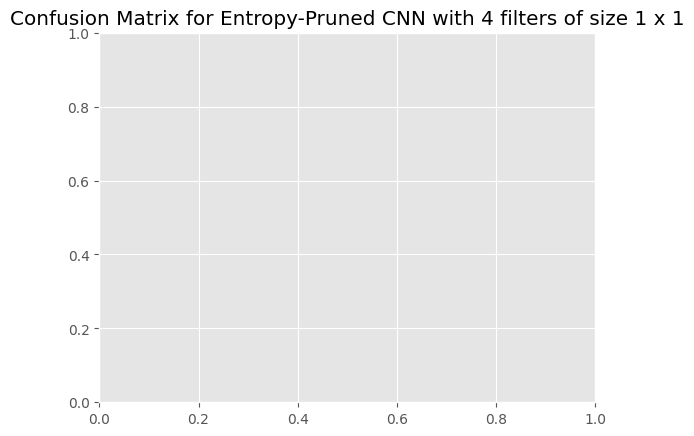

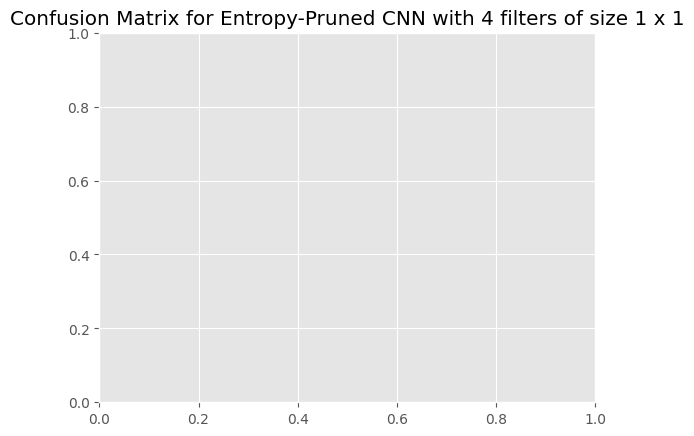

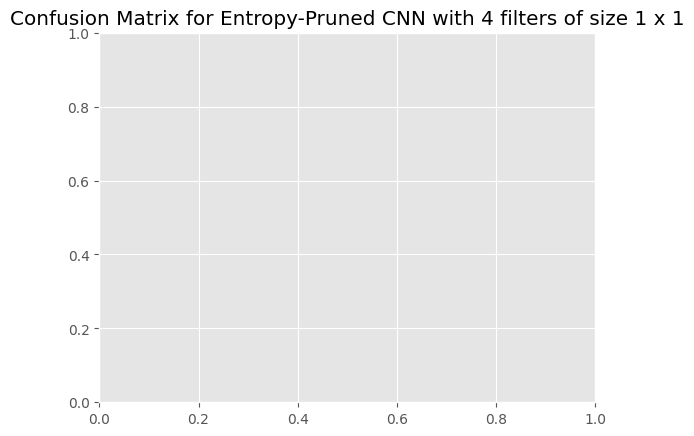

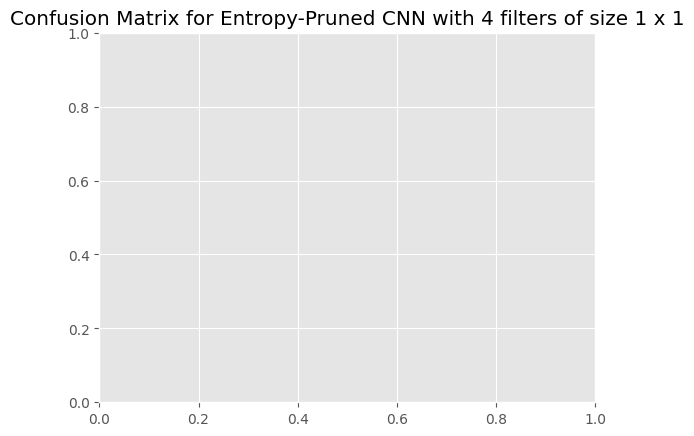

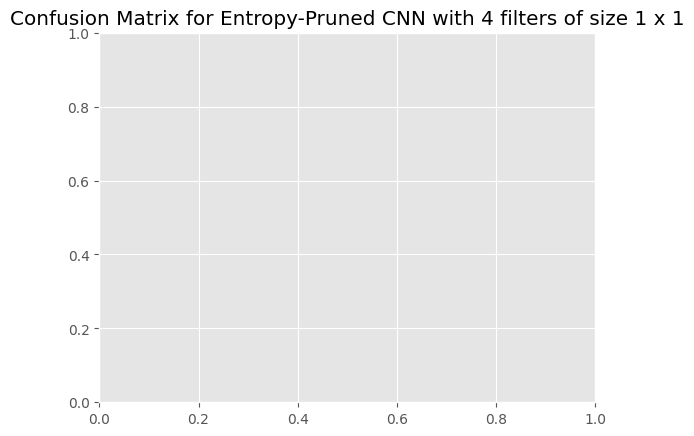

...

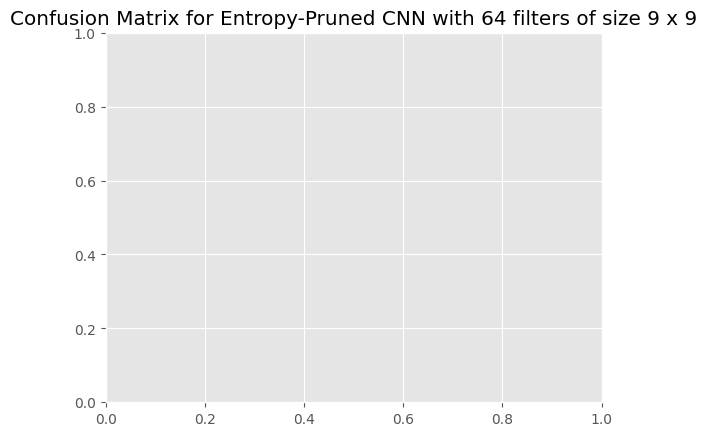

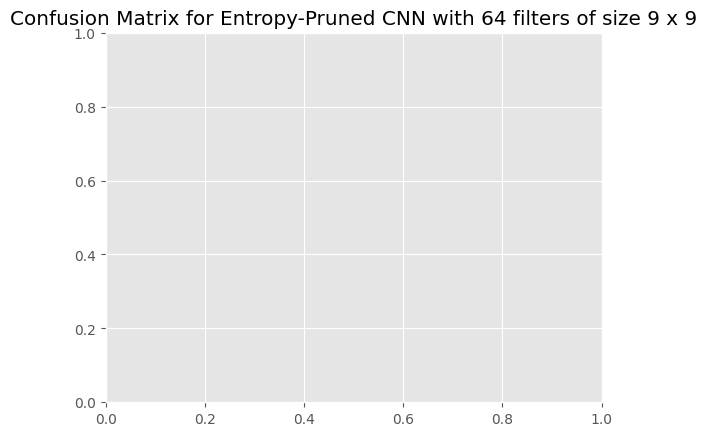

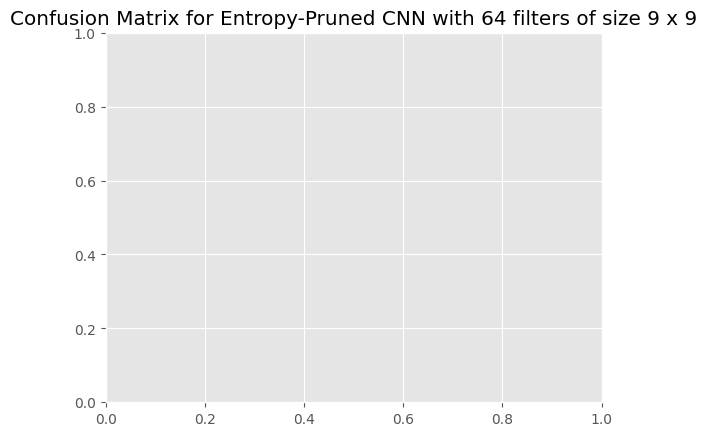

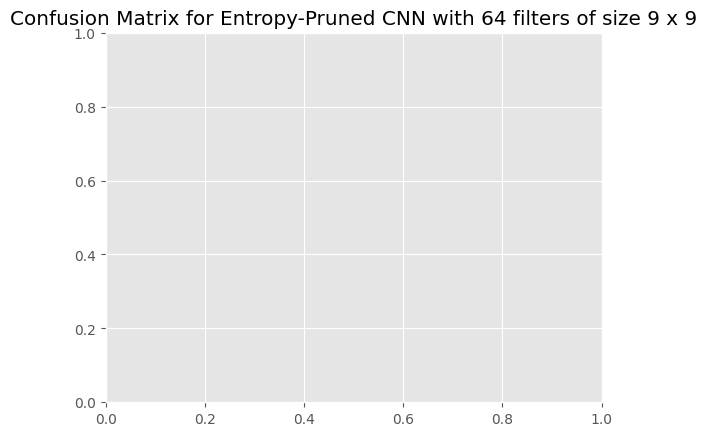

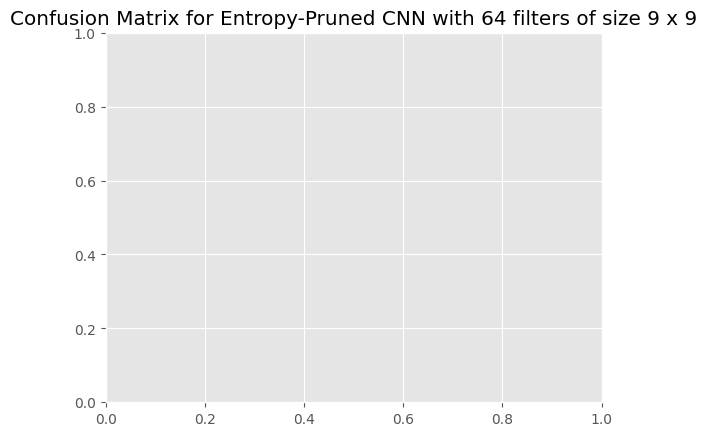

In [ ]:
#i = 0
for num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc in zip(model_df['Number of Filters'],
                                                                                                          model_df['Filter Size'],
                                                                                                          model_df['Probabilities (desc)'],
                                                                                                          model_df['Test Acc (desc)'],
                                                                                                          model_df['Probabilities (asc)'],
                                                                                                          model_df['Test Acc (asc)']):

    #i += 1
    #if i == 1: continue
    #plot_frame(0, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc)    
    for j in range(num_filters + 1):
        plot_confusion(j, num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc)

    frames = []
    for j in range(num_filters + 1):
        image = imageio.v2.imread(f'confusion/{num_filters}_filters/filter_size_{filter_size}/pruned_{j:02d}.png')
        frames.append(image)

    Path(f'confusion_gifs/').mkdir(parents=True, exist_ok=True)

    imageio.v2.mimsave(f'confusion_gifs/{num_filters}_filters_filter_size_{filter_size}.gif', frames, duration = 400)

In [44]:
bigmodel_df = model_df[model_df['Number of Filters'] == 16].copy()

(0.9, 1.0)

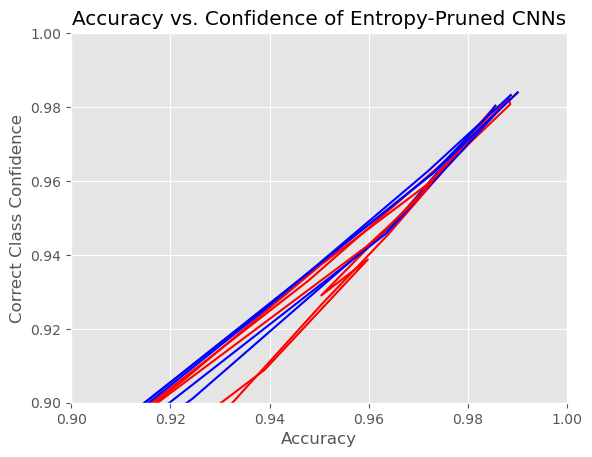

In [45]:
plt.style.use('ggplot')
plt.figure()
    
#fig, axs = plt.subplots(nrows = 1, ncols = 2, sharey='row', figsize=(12, 5))

plt.title('Accuracy vs. Confidence of Entropy-Pruned CNNs')

# Adding titles to subplots
#axs[0].set_title('Descending')
#axs[1].set_title('Ascending')

for num_filters, filter_size, probabilities_desc, test_accs_desc, probabilities_asc, test_accs_asc in zip(bigmodel_df['Number of Filters'],
                                                                                                          bigmodel_df['Filter Size'],
                                                                                                          bigmodel_df['Probabilities (desc)'],
                                                                                                          bigmodel_df['Test Acc (desc)'],
                                                                                                          bigmodel_df['Probabilities (asc)'],
                                                                                                          bigmodel_df['Test Acc (asc)']):
        
    mean_correct_prob_descs = []
    mean_correct_prob_ascs = []
    for j, (probs_desc, probs_asc) in enumerate(zip(probabilities_desc, probabilities_asc)):
        mean_correct_prob_descs.append(probs_desc[range(probs_desc.shape[0]), testY_int].mean())
        mean_correct_prob_ascs.append(probs_asc[range(probs_asc.shape[0]), testY_int].mean())
        
    plt.plot(test_accs_desc, mean_correct_prob_descs, color = 'red', label = 'Descending')
    plt.plot(test_accs_asc, mean_correct_prob_ascs, color = 'blue', label = 'Ascending')
    
#plt.legend()
plt.ylabel('Correct Class Confidence')
plt.xlabel('Accuracy')
plt.xlim(0.9, 1)
plt.ylim(0.9, 1)

## MI-based Pruning 32

In [8]:
model_df = pd.read_pickle('Filter_Number_vs_Size_Prune_Data.pkl')

In [86]:
submodel_df = model_df[(model_df['Number of Filters'] == 32) &
                       ((model_df['Filter Size'] == 3) | (model_df['Filter Size'] == 7) | (model_df['Filter Size'] == 11))]

submodel_df = submodel_df.copy()

submodel_df

,Filename,Number of Filters,Filter Size,Parameters,Val Loss,Val Acc,Stopping Epoch,Filter Entropies,Test CE (asc),Test Acc (asc),Scores (asc),Probabilities (asc),Test CE (desc),Test Acc (desc),Scores (desc),Probabilities (desc)
19,CNN_MNIST_nf_32_fs_3.h5,32,3,54410,0.081566,0.976800,61,"[2427.8413, 2307.6316, 2498.3325, 2240.1135, 2...","[0.06630485504865646, 0.06640855967998505, 0.0...","[0.9803000092506409, 0.9789000153541565, 0.977...","[[[-2.5116558, -6.2580624, 1.2982545, 3.308894...","[[[1.1352881e-09, 2.6795533e-11, 5.1254137e-08...","[0.06630485504865646, 0.07570936530828476, 0.0...","[0.9803000092506409, 0.9761999845504761, 0.970...","[[[-2.5116558, -6.2580624, 1.2982545, 3.308894...","[[[1.1352881e-09, 2.6795533e-11, 5.1254137e-08..."
21,CNN_MNIST_nf_32_fs_7.h5,32,7,40330,0.062460,0.983000,43,"[2198.86, 2231.487, 2174.9912, 2414.3362, 1796...","[0.03925260901451111, 0.05284011363983154, 0.1...","[0.987500011920929, 0.9842000007629395, 0.9574...","[[[-2.4939632, -8.887576, 1.4192228, 1.4919951...","[[[2.1340904e-08, 3.568637e-11, 1.0682868e-06,...","[0.03925260901451111, 0.045891277492046356, 0....","[0.987500011920929, 0.9858999848365784, 0.9793...","[[[-2.4939632, -8.887576, 1.4192228, 1.4919951...","[[[2.1340904e-08, 3.568637e-11, 1.0682868e-06,..."
23,CNN_MNIST_nf_32_fs_11.h5,32,11,29834,0.039341,0.988867,45,"[1557.6879, 2030.0209, 1150.1022, 1415.7045, 1...","[0.03446870669722557, 0.0468808151781559, 0.12...","[0.9890000224113464, 0.9860000014305115, 0.960...","[[[-7.5931096, -6.743617, 1.093515, 2.2642925,...","[[[6.070648e-11, 1.4195974e-10, 3.5957387e-07,...","[0.03446870669722557, 0.03777265176177025, 0.0...","[0.9890000224113464, 0.9879999756813049, 0.987...","[[[-7.5931096, -6.743617, 1.093515, 2.2642925,...","[[[6.070648e-11, 1.4195974e-10, 3.5957387e-07,..."


In [23]:
from sklearn.metrics import mutual_info_score
from mutual_info import calc_MI
from multiprocessing import Pool, cpu_count

def compute_MI_matrix(inputs):
    k, l, data, filter_size = inputs
    
    # extract specified filter activations
    f1_data = data[:,:,:,k]
    f2_data = data[:,:,:,l]

    # dimension of filters
    length = 28 - filter_size + 1
    d = length**2

    # reshape to d-vectors
    f1_data = f1_data.reshape([10000, d])
    f2_data = f2_data.reshape([10000, d])

    # initialize MI matrix
    MI_matrix = np.zeros([d, d])

    # fill in the MI matrix
    pool = Pool(processes = None)

    for i in range(d):
        MI_matrix[i] = pool.map(calc_MI, ((f1_data[:,i], f2_data[:,j], 100) for j in range(d)))
        
    return MI_matrix

In [24]:
# layer 1 = CNN pre-activation
# layer 2 = CNN activation
# layer 5 = Scores
# layer 6 = Probabilities
import time

MI_matrices_models = []

for filename, num_filters, filter_size in zip(submodel_df['Filename'], submodel_df['Number of Filters'], submodel_df['Filter Size']):
    
    model = load_model(filename)
    print('\n============================= Computing filter-level MI for model with', num_filters,
          'filters of size', filter_size, 'x', filter_size, '=============================\n')
    
    feature_maps = extract_layers(model, testX, 2)
    MI_matrices_model = []
    
    for j in range(num_filters):
        for k in range(j+1):
            tic = time.perf_counter() 
            
            #print('Computing MI matrix for filters', j, 'and', k)
            MI_matrix = compute_MI_matrix((j, k, feature_maps, filter_size))
            MI_matrices_model.append(MI_matrix)
            
            toc = time.perf_counter()
            print('Finished with MI matrix for filters %d and %d in %.2f seconds' % (j, k, toc - tic))
            
    MI_matrices_models.append(MI_matrices_model)


============================= Computing filter-level MI for model with 32 filters of size 3 x 3 =============================

Finished with MI matrix for filters 0 and 0 in 88.27 seconds
Finished with MI matrix for filters 1 and 0 in 87.66 seconds
Finished with MI matrix for filters 1 and 1 in 89.15 seconds
Finished with MI matrix for filters 2 and 0 in 88.31 seconds
Finished with MI matrix for filters 2 and 1 in 87.93 seconds
Finished with MI matrix for filters 2 and 2 in 89.54 seconds
Finished with MI matrix for filters 3 and 0 in 88.04 seconds
Finished with MI matrix for filters 3 and 1 in 87.97 seconds
Finished with MI matrix for filters 3 and 2 in 89.15 seconds
Finished with MI matrix for filters 3 and 3 in 87.47 seconds
Finished with MI matrix for filters 4 and 0 in 89.32 seconds
Finished with MI matrix for filters 4 and 1 in 88.54 seconds
Finished with MI matrix for filters 4 and 2 in 87.89 seconds
Finished with MI matrix for filters 4 and 3 in 90.31 seconds
Finished with MI m

In [25]:
import pickle as pkl

In [26]:
with open('MI_matrices_models32.pkl', 'wb') as f:
    pkl.dump(MI_matrices_models, f)

In [30]:
len(MI_matrices_models[2])

528

In [33]:
means_models = []
filter_sizes = [3, 7, 11]
for MI_matrices, filter_size in zip(MI_matrices_models, filter_sizes):

    means = []

    for k in range(32):
        for l in range(k+1):
            MI_matrix = MI_matrices[k+l]
            mean_MI = MI_matrix.mean(axis=0).reshape([28 - filter_size + 1, 28 - filter_size + 1])
            means.append([k, l, np.mean(mean_MI)])

    means = np.array(means)
    
    means_models.append(means)

In [34]:
import pickle as pkl
file = 'MI_matrices_models32.pkl'
MI_matrices_models_load = pkl.load(open(file, 'rb'))

means_models = []
filter_sizes = [3, 7, 11]

for MI_matrices, filter_size in zip(MI_matrices_models_load, filter_sizes):

    means = []

    for k in range(32):
        for l in range(k+1):
            MI_matrix = MI_matrices[k+l]
            mean_MI = MI_matrix.mean(axis=0).reshape([28 - filter_size + 1, 28 - filter_size + 1])
            means.append([k, l, np.mean(mean_MI)])

    means = np.array(means)
    
    means_models.append(means)

In [48]:
#means[means[:, -1].argsort()][::-1]
MMMIs_models = []

for means in means_models:
    MMMIs = np.zeros([32,1])

    for k in range(32):
        for r in means:
            if k in r: MMMIs[k] += r[-1]

    MMMIs_models.append(MMMIs)

In [87]:
 # details we will add to the df for each model
model_details = []
    
for filename, num_filters, filter_size, filter_MMMIs in zip(submodel_df['Filename'],
                                                            submodel_df['Number of Filters'],
                                                            submodel_df['Filter Size'],
                                                            MMMIs_models):
        
    print('Pruning filters by ascending MMMI for a model with', num_filters, 'filters of size', filter_size, 'x', filter_size)
    
    # load the model
    model = load_model(filename)
            
    # sort filter indices in ascending order of MMMI
    filter_MMMI_ascending_args = [int(x) for x in np.argsort(filter_MMMIs[:,0])]

    test_losses = []
    test_accuracies = []
    scoreses = []
    probabilitieses = []
    predictedYs = []
    
    for pruned_filter_index in filter_MMMI_ascending_args:
        
        if pruned_filter_index:
            # get the weights
            weights = model.get_weights()

            # set the removed filter and current filter weights and biases to 0
            weights[0][:, :, 0, pruned_filter_index] *= 0
            weights[1][pruned_filter_index] *= 0
            model.set_weights(weights)

        # compute validation accuracy after removing the current filter
        test_loss, test_accuracy = model.evaluate(testX, testY, verbose = 0)
        
        test_losses.append(test_loss)
        test_accuracies.append(test_accuracy)
                
        # scores
        scores = extract_layers(model, testX, 5)
        scoreses.append(scores)

        # probabilities
        probabilities = extract_layers(model, testX, 6)
        probabilitieses.append(probabilities)
        
    model_details.append([test_losses, test_accuracies, scoreses, probabilitieses])
    
submodel_df['Test Acc (MI asc)'] = model_details[0][1], model_details[1][1], model_details[2][1]
#new_columns = ['Test CE (MI asc)', 'Test Acc (MI asc)', 'Scores (MI asc)', 'Probabilities (MI asc)']
#submodel_df[new_columns] = pd.DataFrame(model_details)

Pruning filters by ascending MMMI for a model with 32 filters of size 3 x 3
Pruning filters by ascending MMMI for a model with 32 filters of size 7 x 7
Pruning filters by ascending MMMI for a model with 32 filters of size 11 x 11


In [90]:
 # details we will add to the df for each model
model_details = []
    
for filename, num_filters, filter_size, filter_MMMIs in zip(submodel_df['Filename'],
                                                            submodel_df['Number of Filters'],
                                                            submodel_df['Filter Size'],
                                                            MMMIs_models):
        
    print('Pruning filters by descending MMMI for a model with', num_filters, 'filters of size', filter_size, 'x', filter_size)
    
    # load the model
    model = load_model(filename)
            
    # sort filter indices in descending order of MMMI
    filter_MMMI_descending_args = [int(x) for x in np.argsort(filter_MMMIs[:,0])][::-1]

    test_losses = []
    test_accuracies = []
    scoreses = []
    probabilitieses = []
    predictedYs = []
    
    for pruned_filter_index in filter_MMMI_descending_args:
        
        if pruned_filter_index:
            # get the weights
            weights = model.get_weights()

            # set the removed filter and current filter weights and biases to 0
            weights[0][:, :, 0, pruned_filter_index] *= 0
            weights[1][pruned_filter_index] *= 0
            model.set_weights(weights)

        # compute validation accuracy after removing the current filter
        test_loss, test_accuracy = model.evaluate(testX, testY, verbose = 0)
        
        test_losses.append(test_loss)
        test_accuracies.append(test_accuracy)
                
        # scores
        scores = extract_layers(model, testX, 5)
        scoreses.append(scores)

        # probabilities
        probabilities = extract_layers(model, testX, 6)
        probabilitieses.append(probabilities)
        
    model_details.append([test_losses, test_accuracies, scoreses, probabilitieses])

submodel_df['Test Acc (MI desc)'] = model_details[0][1], model_details[1][1], model_details[2][1]

#new_columns = ['Test CE (MI desc)', 'Test Acc (MI desc)', 'Scores (MI desc)', 'Probabilities (MI desc)']
#submodel_df[new_columns] = pd.DataFrame(model_details)

Pruning filters by descending MMMI for a model with 32 filters of size 3 x 3
Pruning filters by descending MMMI for a model with 32 filters of size 7 x 7
Pruning filters by descending MMMI for a model with 32 filters of size 11 x 11


In [91]:
submodel_df

,Filename,Number of Filters,Filter Size,Parameters,Val Loss,Val Acc,Stopping Epoch,Filter Entropies,Test CE (asc),Test Acc (asc),Scores (asc),Probabilities (asc),Test CE (desc),Test Acc (desc),Scores (desc),Probabilities (desc),Test Acc (MI asc),Test Acc (MI desc)
19,CNN_MNIST_nf_32_fs_3.h5,32,3,54410,0.081566,0.976800,61,"[2427.8413, 2307.6316, 2498.3325, 2240.1135, 2...","[0.06630485504865646, 0.06640855967998505, 0.0...","[0.9803000092506409, 0.9789000153541565, 0.977...","[[[-2.5116558, -6.2580624, 1.2982545, 3.308894...","[[[1.1352881e-09, 2.6795533e-11, 5.1254137e-08...","[0.06630485504865646, 0.07570936530828476, 0.0...","[0.9803000092506409, 0.9761999845504761, 0.970...","[[[-2.5116558, -6.2580624, 1.2982545, 3.308894...","[[[1.1352881e-09, 2.6795533e-11, 5.1254137e-08...","[0.9797999858856201, 0.9746999740600586, 0.958...","[0.9793000221252441, 0.9772999882698059, 0.972..."
21,CNN_MNIST_nf_32_fs_7.h5,32,7,40330,0.062460,0.983000,43,"[2198.86, 2231.487, 2174.9912, 2414.3362, 1796...","[0.03925260901451111, 0.05284011363983154, 0.1...","[0.987500011920929, 0.9842000007629395, 0.9574...","[[[-2.4939632, -8.887576, 1.4192228, 1.4919951...","[[[2.1340904e-08, 3.568637e-11, 1.0682868e-06,...","[0.03925260901451111, 0.045891277492046356, 0....","[0.987500011920929, 0.9858999848365784, 0.9793...","[[[-2.4939632, -8.887576, 1.4192228, 1.4919951...","[[[2.1340904e-08, 3.568637e-11, 1.0682868e-06,...","[0.98580002784729, 0.9815999865531921, 0.96420...","[0.9872000217437744, 0.9747999906539917, 0.975..."
23,CNN_MNIST_nf_32_fs_11.h5,32,11,29834,0.039341,0.988867,45,"[1557.6879, 2030.0209, 1150.1022, 1415.7045, 1...","[0.03446870669722557, 0.0468808151781559, 0.12...","[0.9890000224113464, 0.9860000014305115, 0.960...","[[[-7.5931096, -6.743617, 1.093515, 2.2642925,...","[[[6.070648e-11, 1.4195974e-10, 3.5957387e-07,...","[0.03446870669722557, 0.03777265176177025, 0.0...","[0.9890000224113464, 0.9879999756813049, 0.987...","[[[-7.5931096, -6.743617, 1.093515, 2.2642925,...","[[[6.070648e-11, 1.4195974e-10, 3.5957387e-07,...","[0.9854000210762024, 0.984000027179718, 0.9836...","[0.9854999780654907, 0.978600025177002, 0.9797..."


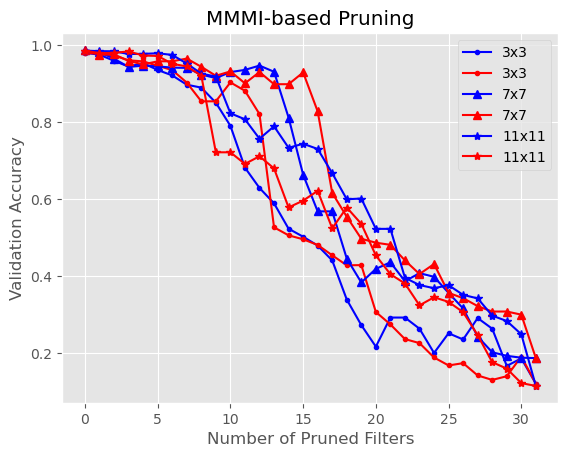

In [93]:
ascending_pruned = submodel_df[submodel_df['Number of Filters'] == 32][['Filter Size', 'Test Acc (MI asc)']]
descending_pruned = submodel_df[submodel_df['Number of Filters'] == 32][['Filter Size', 'Test Acc (MI desc)']]

asc = ascending_pruned.values.tolist()
desc = descending_pruned.values.tolist()

plt.style.use('ggplot')
plt.figure()

markers = ['.', '^', '*']

for i, (x, y) in enumerate(zip(asc, desc)):
    plt.plot(x[1], color = 'blue', marker = markers[i], label = str(x[0]) + 'x' + str(x[0]))
    plt.plot(y[1], color = 'red', marker = markers[i], label = str(y[0]) + 'x' + str(y[0]))

plt.ylabel('Validation Accuracy')
plt.xlabel('Number of Pruned Filters')
plt.title('MMMI-based Pruning')

plt.legend()

## MI-based Pruning

In [94]:
model_df = pd.read_pickle('Filter_Number_vs_Size_Prune_Data.pkl')

In [95]:
submodel_df = model_df[(model_df['Number of Filters'] == 16) &
                       ((model_df['Filter Size'] == 1) | (model_df['Filter Size'] == 5) | (model_df['Filter Size'] == 9))]

submodel_df = submodel_df.copy()

submodel_df

,Filename,Number of Filters,Filter Size,Parameters,Val Loss,Val Acc,Stopping Epoch,Filter Entropies,Test CE (asc),Test Acc (asc),Scores (asc),Probabilities (asc),Test CE (desc),Test Acc (desc),Scores (desc),Probabilities (desc)
12,CNN_MNIST_nf_16_fs_1.h5,16,1,31402,0.268194,0.926400,67,"[3328.919, 3329.6702, 3018.2678, 3344.1362, 29...","[0.23941326141357422, 0.3512614369392395, 0.84...","[0.9312000274658203, 0.892799973487854, 0.7263...","[[[-2.0249403, -8.32229, 1.0330163, 5.585104, ...","[[[9.627664e-08, 1.7726205e-10, 2.049152e-06, ...","[0.23941326141357422, 0.24145835638046265, 0.2...","[0.9312000274658203, 0.9308000206947327, 0.927...","[[[-2.0249403, -8.32229, 1.0330163, 5.585104, ...","[[[9.627664e-08, 1.7726205e-10, 2.049152e-06, ..."
14,CNN_MNIST_nf_16_fs_5.h5,16,5,23466,0.054000,0.984133,57,"[2491.846, 1780.1895, 2372.7683, 2461.791, 245...","[0.04441332817077637, 0.05253654718399048, 0.0...","[0.9854999780654907, 0.983299970626831, 0.9728...","[[[-4.2345734, -8.571398, -0.5155154, 1.121141...","[[[6.462039e-09, 8.4510336e-11, 2.6640078e-07,...","[0.04441332817077637, 0.06972658634185791, 0.1...","[0.9854999780654907, 0.9767000079154968, 0.947...","[[[-4.2345734, -8.571398, -0.5155154, 1.121141...","[[[6.462039e-09, 8.4510336e-11, 2.6640078e-07,..."
16,CNN_MNIST_nf_16_fs_9.h5,16,9,17322,0.047138,0.985667,38,"[1343.6022, 1326.2266, 1819.8556, 1728.0737, 1...","[0.03467980772256851, 0.11512041091918945, 0.3...","[0.9882000088691711, 0.9635000228881836, 0.884...","[[[-4.5799356, -3.7116017, 2.1730754, 1.727340...","[[[2.4064395e-08, 5.7343946e-08, 2.06144e-05, ...","[0.03467980772256851, 0.03580581769347191, 0.0...","[0.9882000088691711, 0.9884999990463257, 0.980...","[[[-4.5799356, -3.7116017, 2.1730754, 1.727340...","[[[2.4064395e-08, 5.7343946e-08, 2.06144e-05, ..."


In [96]:
import pickle as pkl
file = 'MI_matrices_models.pkl'
MI_matrices_models_load = pkl.load(open(file, 'rb'))

means_models = []
filter_sizes = [1, 5, 9]

for MI_matrices, filter_size in zip(MI_matrices_models_load, filter_sizes):

    means = []

    for k in range(32):
        for l in range(k+1):
            MI_matrix = MI_matrices[k+l]
            mean_MI = MI_matrix.mean(axis=0).reshape([28 - filter_size + 1, 28 - filter_size + 1])
            means.append([k, l, np.mean(mean_MI)])

    means = np.array(means)
    
    means_models.append(means)

In [97]:
#means[means[:, -1].argsort()][::-1]
MMMIs_models = []

for means in means_models:
    MMMIs = np.zeros([16,1])

    for k in range(16):
        for r in means:
            if k in r: MMMIs[k] += r[-1]

    MMMIs_models.append(MMMIs)

In [98]:
 # details we will add to the df for each model
model_details = []
    
for filename, num_filters, filter_size, filter_MMMIs in zip(submodel_df['Filename'],
                                                            submodel_df['Number of Filters'],
                                                            submodel_df['Filter Size'],
                                                            MMMIs_models):
        
    print('Pruning filters by ascending MMMI for a model with', num_filters, 'filters of size', filter_size, 'x', filter_size)
    
    # load the model
    model = load_model(filename)
            
    # sort filter indices in ascending order of MMMI
    filter_MMMI_ascending_args = [int(x) for x in np.argsort(filter_MMMIs[:,0])]

    test_losses = []
    test_accuracies = []
    scoreses = []
    probabilitieses = []
    predictedYs = []
    
    for pruned_filter_index in filter_MMMI_ascending_args:
        
        if pruned_filter_index:
            # get the weights
            weights = model.get_weights()

            # set the removed filter and current filter weights and biases to 0
            weights[0][:, :, 0, pruned_filter_index] *= 0
            weights[1][pruned_filter_index] *= 0
            model.set_weights(weights)

        # compute validation accuracy after removing the current filter
        test_loss, test_accuracy = model.evaluate(testX, testY, verbose = 0)
        
        test_losses.append(test_loss)
        test_accuracies.append(test_accuracy)
                
        # scores
        scores = extract_layers(model, testX, 5)
        scoreses.append(scores)

        # probabilities
        probabilities = extract_layers(model, testX, 6)
        probabilitieses.append(probabilities)
        
    model_details.append([test_losses, test_accuracies, scoreses, probabilitieses])
    
submodel_df['Test Acc (MI asc)'] = model_details[0][1], model_details[1][1], model_details[2][1]
#new_columns = ['Test CE (MI asc)', 'Test Acc (MI asc)', 'Scores (MI asc)', 'Probabilities (MI asc)']
#submodel_df[new_columns] = pd.DataFrame(model_details)

Pruning filters by ascending MMMI for a model with 16 filters of size 1 x 1
Pruning filters by ascending MMMI for a model with 16 filters of size 5 x 5
Pruning filters by ascending MMMI for a model with 16 filters of size 9 x 9


In [99]:
 # details we will add to the df for each model
model_details = []
    
for filename, num_filters, filter_size, filter_MMMIs in zip(submodel_df['Filename'],
                                                            submodel_df['Number of Filters'],
                                                            submodel_df['Filter Size'],
                                                            MMMIs_models):
        
    print('Pruning filters by descending MMMI for a model with', num_filters, 'filters of size', filter_size, 'x', filter_size)
    
    # load the model
    model = load_model(filename)
            
    # sort filter indices in descending order of MMMI
    filter_MMMI_descending_args = [int(x) for x in np.argsort(filter_MMMIs[:,0])][::-1]

    test_losses = []
    test_accuracies = []
    scoreses = []
    probabilitieses = []
    predictedYs = []
    
    for pruned_filter_index in filter_MMMI_descending_args:
        
        if pruned_filter_index:
            # get the weights
            weights = model.get_weights()

            # set the removed filter and current filter weights and biases to 0
            weights[0][:, :, 0, pruned_filter_index] *= 0
            weights[1][pruned_filter_index] *= 0
            model.set_weights(weights)

        # compute validation accuracy after removing the current filter
        test_loss, test_accuracy = model.evaluate(testX, testY, verbose = 0)
        
        test_losses.append(test_loss)
        test_accuracies.append(test_accuracy)
                
        # scores
        scores = extract_layers(model, testX, 5)
        scoreses.append(scores)

        # probabilities
        probabilities = extract_layers(model, testX, 6)
        probabilitieses.append(probabilities)
        
    model_details.append([test_losses, test_accuracies, scoreses, probabilitieses])

submodel_df['Test Acc (MI desc)'] = model_details[0][1], model_details[1][1], model_details[2][1]

#new_columns = ['Test CE (MI desc)', 'Test Acc (MI desc)', 'Scores (MI desc)', 'Probabilities (MI desc)']
#submodel_df[new_columns] = pd.DataFrame(model_details)

Pruning filters by descending MMMI for a model with 16 filters of size 1 x 1
Pruning filters by descending MMMI for a model with 16 filters of size 5 x 5
Pruning filters by descending MMMI for a model with 16 filters of size 9 x 9


In [100]:
submodel_df

,Filename,Number of Filters,Filter Size,Parameters,Val Loss,Val Acc,Stopping Epoch,Filter Entropies,Test CE (asc),Test Acc (asc),Scores (asc),Probabilities (asc),Test CE (desc),Test Acc (desc),Scores (desc),Probabilities (desc),Test Acc (MI asc),Test Acc (MI desc)
12,CNN_MNIST_nf_16_fs_1.h5,16,1,31402,0.268194,0.926400,67,"[3328.919, 3329.6702, 3018.2678, 3344.1362, 29...","[0.23941326141357422, 0.3512614369392395, 0.84...","[0.9312000274658203, 0.892799973487854, 0.7263...","[[[-2.0249403, -8.32229, 1.0330163, 5.585104, ...","[[[9.627664e-08, 1.7726205e-10, 2.049152e-06, ...","[0.23941326141357422, 0.24145835638046265, 0.2...","[0.9312000274658203, 0.9308000206947327, 0.927...","[[[-2.0249403, -8.32229, 1.0330163, 5.585104, ...","[[[9.627664e-08, 1.7726205e-10, 2.049152e-06, ...","[0.9312000274658203, 0.930899977684021, 0.8967...","[0.8878999948501587, 0.7124999761581421, 0.712..."
14,CNN_MNIST_nf_16_fs_5.h5,16,5,23466,0.054000,0.984133,57,"[2491.846, 1780.1895, 2372.7683, 2461.791, 245...","[0.04441332817077637, 0.05253654718399048, 0.0...","[0.9854999780654907, 0.983299970626831, 0.9728...","[[[-4.2345734, -8.571398, -0.5155154, 1.121141...","[[[6.462039e-09, 8.4510336e-11, 2.6640078e-07,...","[0.04441332817077637, 0.06972658634185791, 0.1...","[0.9854999780654907, 0.9767000079154968, 0.947...","[[[-4.2345734, -8.571398, -0.5155154, 1.121141...","[[[6.462039e-09, 8.4510336e-11, 2.6640078e-07,...","[0.9815999865531921, 0.9480000138282776, 0.949...","[0.9854999780654907, 0.9833999872207642, 0.980..."
16,CNN_MNIST_nf_16_fs_9.h5,16,9,17322,0.047138,0.985667,38,"[1343.6022, 1326.2266, 1819.8556, 1728.0737, 1...","[0.03467980772256851, 0.11512041091918945, 0.3...","[0.9882000088691711, 0.9635000228881836, 0.884...","[[[-4.5799356, -3.7116017, 2.1730754, 1.727340...","[[[2.4064395e-08, 5.7343946e-08, 2.06144e-05, ...","[0.03467980772256851, 0.03580581769347191, 0.0...","[0.9882000088691711, 0.9884999990463257, 0.980...","[[[-4.5799356, -3.7116017, 2.1730754, 1.727340...","[[[2.4064395e-08, 5.7343946e-08, 2.06144e-05, ...","[0.9855999946594238, 0.9797999858856201, 0.979...","[0.9865000247955322, 0.9731000065803528, 0.962..."


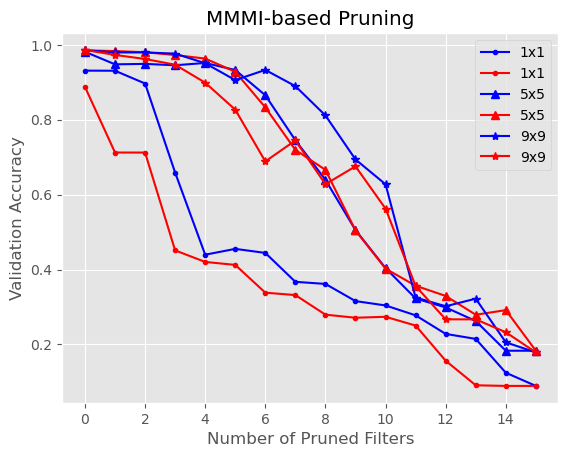

In [101]:
ascending_pruned = submodel_df[submodel_df['Number of Filters'] == 16][['Filter Size', 'Test Acc (MI asc)']]
descending_pruned = submodel_df[submodel_df['Number of Filters'] == 16][['Filter Size', 'Test Acc (MI desc)']]

asc = ascending_pruned.values.tolist()
desc = descending_pruned.values.tolist()

plt.style.use('ggplot')
plt.figure()

markers = ['.', '^', '*']

for i, (x, y) in enumerate(zip(asc, desc)):
    plt.plot(x[1], color = 'blue', marker = markers[i], label = str(x[0]) + 'x' + str(x[0]))
    plt.plot(y[1], color = 'red', marker = markers[i], label = str(y[0]) + 'x' + str(y[0]))

plt.ylabel('Validation Accuracy')
plt.xlabel('Number of Pruned Filters')
plt.title('MMMI-based Pruning')

plt.legend()